# Overview
The goal of this competition is to predict overall writing quality. Does typing behavior affect the outcome of an essay? You will develop a model trained on a large dataset of keystroke logs that have captured writing process features.



## Introduction
This notebook addresses the Kaggle competition "Linking Writing Processes to Writing Quality," where the goal is to predict essay quality based on typing behavior. In this analysis, we explore the provided dataset, perform feature engineering, build predictive models, and visualize the results.

# Data Exploration and Preprocessing
Let us start by exploring the training data, visualizing essay quality distribution, and identifying key patterns in typing behavior.
**Also don't forget to import our loved ones** ;)) 

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold

import warnings
warnings.filterwarnings("ignore", category=UserWarning)
import optuna 
import lightgbm as lgb
from sklearn.metrics import mean_squared_error

print('Import sucessful, for libraries')

# Load the training and test data
train_logs = pd.read_csv('/kaggle/input/linking-writing-processes-to-writing-quality/train_logs.csv')
test_logs = pd.read_csv('/kaggle/input/linking-writing-processes-to-writing-quality/test_logs.csv')
train_scores = pd.read_csv('/kaggle/input/linking-writing-processes-to-writing-quality/train_scores.csv')

# Check data structure and initial summary
print(train_logs.head())
print(train_logs.info())

Import sucessful, for libraries
         id  event_id  down_time  up_time  action_time       activity  \
0  001519c8         1       4526     4557           31  Nonproduction   
1  001519c8         2       4558     4962          404  Nonproduction   
2  001519c8         3     106571   106571            0  Nonproduction   
3  001519c8         4     106686   106777           91          Input   
4  001519c8         5     107196   107323          127          Input   

  down_event   up_event text_change  cursor_position  word_count  
0  Leftclick  Leftclick    NoChange                0           0  
1  Leftclick  Leftclick    NoChange                0           0  
2      Shift      Shift    NoChange                0           0  
3          q          q           q                1           1  
4          q          q           q                2           1  
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8405898 entries, 0 to 8405897
Data columns (total 11 columns):
 #   Column   

# Data Visualization
Let's take a initial look on our data to undertand the structure

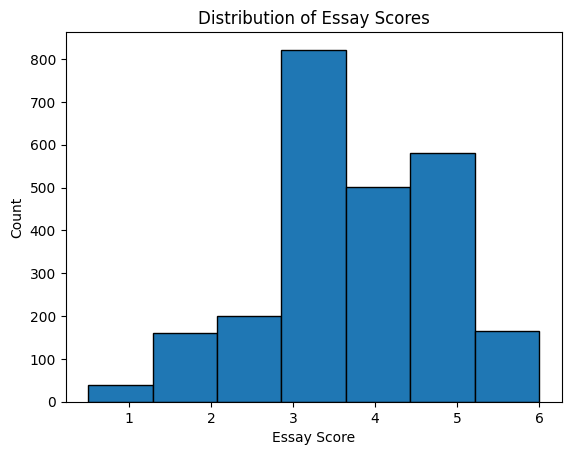

In [2]:
# Create a histogram of essay scores
plt.hist(train_scores['score'], bins=7, edgecolor='k')
plt.xlabel('Essay Score')
plt.ylabel('Count')
plt.title('Distribution of Essay Scores')
plt.show()

In [3]:
train_logs['activity'].nunique()

50

In [4]:
print(train_logs.groupby("id")['event_id'].size())
print(train_logs.groupby("id")['cursor_position'].max())

id
001519c8    2557
0022f953    2454
0042269b    4136
0059420b    1556
0075873a    2531
            ... 
ffb8c745    4739
ffbef7e5    2604
ffccd6fd    3063
ffec5b38    3242
fff05981    3619
Name: event_id, Length: 2471, dtype: int64
id
001519c8    1539
0022f953    1676
0042269b    2291
0059420b    1047
0075873a    1402
            ... 
ffb8c745    1634
ffbef7e5    1877
ffccd6fd    2761
ffec5b38    2133
fff05981    1496
Name: cursor_position, Length: 2471, dtype: int64


# Feature Engineering

Let's extract relevant features from the typing behavior data, such as pause frequency and revision counts, etc. These features are used to train our machine learning models.

In [5]:
print(train_logs['activity'].value_counts().head(10))

activity
Input                                     6726796
Remove/Cut                                 970158
Nonproduction                              703851
Replace                                      4448
Paste                                         599
Move From [1306, 1371] To [1061, 1126]          2
Move From [13, 65] To [9, 61]                   1
Move From [274, 314] To [299, 339]              1
Move From [624, 625] To [845, 846]              1
Move From [1861, 2063] To [1766, 1968]          1
Name: count, dtype: int64


In [6]:
train_logs['text_change'].value_counts().head(25)

text_change
q              6128208
               1376829
NoChange        703851
.                67797
,                54797
\n               27977
'                13192
"                 4659
-                 4492
?                 3507
;                 2905
=                 2288
/                 1354
\                 1100
:                  813
(                  733
[                  725
)                  660
!                  639
q => q             238
qqqq => q          205
qqq => q           191
>                  177
qqqqqq => q        165
]                  157
Name: count, dtype: int64

In [7]:
#train_logs.isnull().sum()

In [8]:
import re
def feat_eng(train_logs):
    
    train_logs_initial = train_logs.loc[train_logs.groupby('id')['event_id'].idxmin()].set_index('id')
    train_logs_final = train_logs.loc[train_logs.groupby('id')['event_id'].idxmax()].set_index('id')
    
 
    grouped_data = train_logs.groupby('id')

    grouped_data = grouped_data.agg({
        'event_id': 'count',
        'action_time': 'sum',
        'cursor_position': 'max',
        'word_count': 'max'
    })
    grouped_data['total_time'] = train_logs_final['up_time'] - train_logs_initial['down_time']
    grouped_data['word_count'] = train_logs_final.word_count
    grouped_data['prod_rate'] = train_logs[train_logs.activity == 'Input']['id'].value_counts() * 60 * 1000 / grouped_data['total_time']

    grouped_data['initial_pause_time'] = train_logs_initial['down_time']
    
    train_logs_grouped = train_logs.groupby('id')
    grouped_data['mean_IKI'] = train_logs_grouped.down_time.agg(lambda x: (x - x.shift(1)).mean())
    grouped_data['median_IKI'] = train_logs_grouped.down_time.agg(lambda x: (x - x.shift(1)).median())
    grouped_data['std_IKI'] = train_logs_grouped.down_time.agg(lambda x: (x - x.shift(1)).std())
    grouped_data['num_pauses'] = train_logs_grouped.down_time.agg(lambda x: ((x - x.shift(1)) > 1000).sum())

    # Get the top 10 most frequent 'activity' values
    top_activity_values = train_logs['activity'].value_counts().nlargest(5).index

    # Get the top 50 most frequent 'text_change' values
    top_text_change_values = train_logs['text_change'].value_counts().nlargest(25).index

    # Filter 'activity' and 'text_change' columns based on the top values
    filtered_merged_data = train_logs[train_logs['activity'].isin(top_activity_values)]
    filtered_merged_data = filtered_merged_data[filtered_merged_data['text_change'].isin(top_text_change_values)]

    # Group by 'id' and transform to get the count for each 'activity' and 'text_change' value
    activity_counts = filtered_merged_data.groupby('id')['activity'].value_counts().unstack(fill_value=0)
    text_change_counts = filtered_merged_data.groupby('id')['text_change'].value_counts().unstack(fill_value=0)

    # Concatenate the count columns to the grouped_data DataFrame
    grouped_data = pd.concat([grouped_data, activity_counts, text_change_counts], axis=1)
    
   
    def convert_special_characters_to_ascii(df):
        new_columns = []
        for col in df.columns:
            if not col.isidentifier():
                # Convert special characters to their ASCII codes
                new_col = ''.join([str(ord(c)) for c in col])
            else:
                new_col = col
            new_columns.append(new_col)
        df.columns = new_columns
        return df

    # Convert column names with special characters to ASCII codes
    grouped_data = convert_special_characters_to_ascii(grouped_data)
    """columns_to_drop = [col for col in grouped_data.columns if not col.isidentifier()]
    # Drop the identified columns
    grouped_data.drop(columns=columns_to_drop, inplace=True)"""
    
    """grouped_data = grouped_data.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', 'a', x))
    new_column_names = {}

    # Rename the columns
    grouped_data.rename(columns=new_column_names, inplace=True)

    # Function to rename columns with duplicate names
    def rename_duplicate_columns(df):
        cols = pd.Series(df.columns)
        for dup in df.columns[df.columns.duplicated(keep=False)]:
            cols[df.columns.get_loc(dup)] = [dup + f'_{i}' if i != 0 else dup for i in range(sum(df.columns == dup))]
        df.columns = cols

        return df

    # Rename columns with duplicated names
    grouped_data = rename_duplicate_columns(grouped_data)"""

    return grouped_data

In [9]:
train_df = feat_eng(train_logs)
train_df = train_df.merge(train_scores, on='id')
train_df = train_df.drop(columns=['id'])
train_df

,event_id,action_time,cursor_position,word_count,total_time,prod_rate,initial_pause_time,mean_IKI,median_IKI,std_IKI,...,NoChange,91,92,93,q,11332616232113,11311311332616232113,11311311311332616232113,11311311311311311332616232113,score
0,2557,297243,1539,255,1797443,67.095313,4526,703.188967,151.0,4296.265374,...,120,0,0,0,1939,0,0,0,0,3.5
1,2454,275391,1676,320,1758346,66.130329,30623,716.762740,160.0,4895.361707,...,254,0,0,0,1698,0,0,0,1,3.5
2,4136,421201,2291,404,1767228,119.339440,4441,427.274002,94.0,3939.697088,...,175,0,0,0,3257,0,0,0,0,6.0
3,1556,189596,1047,206,1363074,57.399672,41395,876.526688,256.0,4248.876748,...,99,0,0,0,1146,0,0,0,0,2.0
4,2531,313702,1402,252,1584002,73.560513,78470,626.055336,166.5,3897.155465,...,72,0,0,0,1964,0,0,0,0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2466,4739,499670,1634,273,1769182,121.683354,22467,373.388350,118.0,3458.035814,...,189,0,0,0,3605,0,0,1,0,3.5
2467,2604,214221,1877,438,1777442,80.846520,21732,682.824433,258.0,5633.079728,...,148,0,0,0,1920,1,0,0,0,4.0
2468,3063,231580,2761,201,1935881,88.300882,23482,632.198236,207.0,5400.255418,...,126,0,0,0,1031,0,0,0,0,1.5
2469,3242,289439,2133,413,1488619,116.685330,19885,459.256402,168.0,3460.963973,...,71,2,0,0,2593,0,0,0,0,5.0


## Hyperparameter Optimization with Optuna

In [10]:

def objective(trial,data=train_df.drop(columns='score'),target=train_df['score']):
    
    X_train, X_val, y_train, y_val = train_test_split(data, target, test_size=0.2, random_state=4)
    
    param = {
        'metric': 'rmse',
        'n_estimators': 10000,
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1),
        'subsample': trial.suggest_float('subsample', 0.5, 1),
        'learning_rate': trial.suggest_float('learning_rate', 1e-4, 0.1, log=True),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 32),
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 100),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0.0, 1.0),  # Minimum gain to split
        "max_depth": trial.suggest_int("max_depth", 3, 15),  # Set a maximum depth
    }
    dtrain = lgb.Dataset(X_train, label=y_train)
    dvalid = lgb.Dataset(X_val, label=y_val)
    
    model = lgb.train(param, dtrain, valid_sets=[dtrain, dvalid],early_stopping_rounds=100, verbose_eval=True)
    
    y_pred = model.predict(X_val)
    rmse = mean_squared_error(y_val, y_pred,squared=False)
    return rmse

In [11]:
num_trials_optuna = 100
study = optuna.create_study(direction='minimize', study_name='Optimize boosting hyperparameters')
study.optimize(objective, n_trials=num_trials_optuna)


[I 2023-10-27 09:33:16,373] A new study created in memory with name: Optimize boosting hyperparameters
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002157 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4760
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 38
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00901	valid_1's rmse: 1.06759
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00551	valid_1's rmse: 1.06416
[3]	training's rmse: 1.0018	valid_1's rmse: 1.06043
[4]	training's rmse: 0.99813	valid_1's rmse: 1.05699
[5]	training's rmse: 0.994603	valid_1's rmse: 1.05357
[6]	training's rmse: 0.991002	valid_1's rmse: 1.04999
[7]	training's rmse: 0.987437	valid_1's rmse: 1.04661
[8]	training's rmse: 0.983955	valid_1's rmse: 1.04312
[9]	training's rmse: 0.980461	valid_1's rmse: 1.0398
[10]	training's rmse: 0.977309	valid_1's rmse: 1.03673
[11]	training's rmse: 0.973877	valid_1's rmse: 1.0335
[12]	

[I 2023-10-27 09:33:18,963] Trial 0 finished with value: 0.6858191285416634 and parameters: {'reg_alpha': 6.062330982089648, 'reg_lambda': 0.044467485241852525, 'colsample_bytree': 0.5473622986128691, 'subsample': 0.7470714483892344, 'learning_rate': 0.007014194428615236, 'num_leaves': 8, 'min_child_samples': 88, 'min_gain_to_split': 0.3140297681958405, 'max_depth': 6}. Best is trial 0 with value: 0.6858191285416634.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_log

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002278 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01255	valid_1's rmse: 1.07102
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01233	valid_1's rmse: 1.07082
[3]	training's rmse: 1.01212	valid_1's rmse: 1.07062
[4]	training's rmse: 1.01191	valid_1's rmse: 1.07041
[5]	training's rmse: 1.01169	valid_1's rmse: 1.07021
[6]	training's rmse: 1.01148	valid_1's rmse: 1.07001
[7]	training's rmse: 1.01128	valid_1's rmse: 1.0698
[8]	training's rmse: 1.01107	valid_1's rmse: 1.0696
[9]	training's rmse: 1.01086	valid_1's rmse: 1.0694
[10]	training's rmse: 1.01065	valid_1's rmse: 1.0692
[11]	training's rmse: 1.01044	valid_1's rmse: 1.06899
[12]	training

[I 2023-10-27 09:34:00,810] Trial 1 finished with value: 0.6781343147049903 and parameters: {'reg_alpha': 0.0696165654629955, 'reg_lambda': 0.0010427433638632913, 'colsample_bytree': 0.6116566058831476, 'subsample': 0.6654753282773851, 'learning_rate': 0.00035812516021511254, 'num_leaves': 17, 'min_child_samples': 21, 'min_gain_to_split': 0.6761615329242323, 'max_depth': 5}. Best is trial 1 with value: 0.6781343147049903.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugges

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4760
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 38
[LightGBM] [Info] Start training from score 3.706478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[1]	training's rmse: 1.01246	valid_1's rmse: 1.07094
Training until validation scores don't improve for 100 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[2]	training's rmse: 1.01216	valid_1's rmse: 1.07065
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[3]	training's rmse: 1.01186	valid_1's rmse: 1.07037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[4]	training's rmse: 1.01156	valid_1's rmse: 1.07008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[5]	tra

[I 2023-10-27 09:34:31,744] Trial 2 finished with value: 0.6858694209645309 and parameters: {'reg_alpha': 1.2507769477800323, 'reg_lambda': 0.002038344367137464, 'colsample_bytree': 0.8812374745152303, 'subsample': 0.5496164173493435, 'learning_rate': 0.0005112580637200058, 'num_leaves': 19, 'min_child_samples': 87, 'min_gain_to_split': 0.7348374573964741, 'max_depth': 7}. Best is trial 1 with value: 0.6781343147049903.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002370 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4764
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 39
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01139	valid_1's rmse: 1.06987
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01003	valid_1's rmse: 1.06853
[3]	training's rmse: 1.00877	valid_1's rmse: 1.06732
[4]	training's rmse: 1.00742	valid_1's rmse: 1.06598
[5]	training's rmse: 1.00608	valid_1's rmse: 1.06465
[6]	training's rmse: 1.00474	valid_1's rmse: 1.06333
[7]	training's rmse: 1.00341	valid_1's rmse: 1.062
[8]	training's rmse: 1.00208	valid_1's rmse: 1.06069
[9]	training's rmse: 1.00076	valid_1's rmse: 1.05944
[10]	training's rmse: 0.999447	valid_1's rmse: 1.05814
[11]	training's rmse: 0.998138	valid_1's rmse: 1.05683
[12]	trai

[I 2023-10-27 09:34:37,164] Trial 3 finished with value: 0.6776957449719392 and parameters: {'reg_alpha': 0.006536866280947693, 'reg_lambda': 0.05633241146404068, 'colsample_bytree': 0.7802932644541475, 'subsample': 0.6996867444584658, 'learning_rate': 0.003074532220739903, 'num_leaves': 3, 'min_child_samples': 43, 'min_gain_to_split': 0.7832824901964512, 'max_depth': 7}. Best is trial 3 with value: 0.6776957449719392.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_l

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002120 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0115	valid_1's rmse: 1.07003
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01025	valid_1's rmse: 1.06884
[3]	training's rmse: 1.009	valid_1's rmse: 1.06765
[4]	training's rmse: 1.00775	valid_1's rmse: 1.06649
[5]	training's rmse: 1.0065	valid_1's rmse: 1.0653
[6]	training's rmse: 1.00526	valid_1's rmse: 1.06412
[7]	training's rmse: 1.00402	valid_1's rmse: 1.06295
[8]	training's rmse: 1.00281	valid_1's rmse: 1.06181
[9]	training's rmse: 1.00157	valid_1's rmse: 1.06069
[10]	training's rmse: 1.00036	valid_1's rmse: 1.05957
[11]	training's rmse: 0.999137	valid_1's rmse: 1.05841
[12]	training

[I 2023-10-27 09:34:49,694] Trial 4 finished with value: 0.6784202551166155 and parameters: {'reg_alpha': 0.09012887353942856, 'reg_lambda': 0.01647046176192167, 'colsample_bytree': 0.8847767675308638, 'subsample': 0.6562823902204393, 'learning_rate': 0.0019882258488162245, 'num_leaves': 28, 'min_child_samples': 23, 'min_gain_to_split': 0.7072652900363384, 'max_depth': 9}. Best is trial 3 with value: 0.6776957449719392.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002048 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4752
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 37
[LightGBM] [Info] Start training from score 3.706478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[1]	training's rmse: 1.01251	valid_1's rmse: 1.07099
Training until validation scores don't improve for 100 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[2]	training's rmse: 1.01227	valid_1's rmse: 1.07075
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[3]	training's rmse: 1.01202	valid_1's rmse: 1.0705
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[4]	training's rmse: 1.01177	valid_1's rmse: 1.07026
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[5]	trai

[I 2023-10-27 09:35:20,053] Trial 5 finished with value: 0.6887986800391482 and parameters: {'reg_alpha': 5.929201545245689, 'reg_lambda': 5.940263687877878, 'colsample_bytree': 0.9442180068351358, 'subsample': 0.7455667532498576, 'learning_rate': 0.0004614296961074924, 'num_leaves': 25, 'min_child_samples': 99, 'min_gain_to_split': 0.3056460249645484, 'max_depth': 6}. Best is trial 3 with value: 0.6776957449719392.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_logu

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002303 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01263	valid_1's rmse: 1.0711
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01251	valid_1's rmse: 1.07098
[3]	training's rmse: 1.01238	valid_1's rmse: 1.07085
[4]	training's rmse: 1.01225	valid_1's rmse: 1.07073
[5]	training's rmse: 1.01213	valid_1's rmse: 1.0706
[6]	training's rmse: 1.012	valid_1's rmse: 1.07048
[7]	training's rmse: 1.01187	valid_1's rmse: 1.07036
[8]	training's rmse: 1.01175	valid_1's rmse: 1.07023
[9]	training's rmse: 1.01162	valid_1's rmse: 1.07011
[10]	training's rmse: 1.01149	valid_1's rmse: 1.06998
[11]	training's rmse: 1.01137	valid_1's rmse: 1.06986
[12]	training

[I 2023-10-27 09:35:41,997] Trial 6 finished with value: 0.706405544420588 and parameters: {'reg_alpha': 0.00830039022332602, 'reg_lambda': 0.010969140625261407, 'colsample_bytree': 0.9666974551343148, 'subsample': 0.9223905886512096, 'learning_rate': 0.00022812797389986958, 'num_leaves': 19, 'min_child_samples': 14, 'min_gain_to_split': 0.23691322734243214, 'max_depth': 3}. Best is trial 3 with value: 0.6776957449719392.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugges

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001575 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 0.979268	valid_1's rmse: 1.04035
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.947828	valid_1's rmse: 1.0118
[3]	training's rmse: 0.918358	valid_1's rmse: 0.985251
[4]	training's rmse: 0.891197	valid_1's rmse: 0.960843
[5]	training's rmse: 0.866276	valid_1's rmse: 0.938508
[6]	training's rmse: 0.842575	valid_1's rmse: 0.91699
[7]	training's rmse: 0.820651	valid_1's rmse: 0.898246
[8]	training's rmse: 0.800774	valid_1's rmse: 0.881418
[9]	training's rmse: 0.781883	valid_1's rmse: 0.86505
[10]	training's rmse: 0.763854	valid_1's

[I 2023-10-27 09:35:42,609] Trial 7 finished with value: 0.678051881832887 and parameters: {'reg_alpha': 0.43854266395926106, 'reg_lambda': 0.01942692469339128, 'colsample_bytree': 0.5016600380427076, 'subsample': 0.5469740547432367, 'learning_rate': 0.054228248705550965, 'num_leaves': 26, 'min_child_samples': 2, 'min_gain_to_split': 0.6541215009792165, 'max_depth': 8}. Best is trial 3 with value: 0.6776957449719392.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	training's rmse: 0.485592	valid_1's rmse: 0.681383
[61]	training's rmse: 0.483677	valid_1's rmse: 0.680992
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[62]	training's rmse: 0.482675	valid_1's rmse: 0.680967
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[63]	training's rmse: 0.481506	valid_1's rmse: 0.68094
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[64]	training's rmse: 0.480711	valid_1's rmse: 0.680537
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[65]	training's rmse: 0.479846	valid_1's rmse: 0.680369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[66]	training's rmse: 0.479627	valid_1's rmse: 0.680287
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[67]	training's rmse: 0.478212	valid_1's rmse: 0.680217
[LightGBM] [Warning] No furt

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0127	valid_1's rmse: 1.07117
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01265	valid_1's rmse: 1.07111
[3]	training's rmse: 1.01259	valid_1's rmse: 1.07106
[4]	training's rmse: 1.01253	valid_1's rmse: 1.071
[5]	training's rmse: 1.01247	valid_1's rmse: 1.07094
[6]	training's rmse: 1.01242	valid_1's rmse: 1.07089
[7]	training's rmse: 1.01236	valid_1's rmse: 1.07083
[8]	training's rmse: 1.0123	valid_1's rmse: 1.07077
[9]	training's rmse: 1.01224	valid_1's rmse: 1.07072
[10]	training's rmse: 1.01218	valid_1's rmse: 1.07066
[11]	training's rmse: 1.01213	valid_1's rmse: 1.0706
[12]	training's rmse: 1.01207	valid_1's rmse: 1.07055
[13]	training's rmse: 1.01201	valid_1's rmse: 1.07049
[14]	training's rmse: 1.01195	valid_1's rmse: 1.07043
[15]	training's rmse: 1.0119	valid_1's rmse: 1.07038
[16]	training's rmse: 1.01184	valid_1's rmse: 1.07032
[17]	training's rmse: 1.01178	valid_

[I 2023-10-27 09:36:07,905] Trial 8 finished with value: 0.7800733125862783 and parameters: {'reg_alpha': 0.001650529304078929, 'reg_lambda': 0.18402057874975514, 'colsample_bytree': 0.9210584140886766, 'subsample': 0.5008729464421462, 'learning_rate': 0.00010514349516717584, 'num_leaves': 7, 'min_child_samples': 79, 'min_gain_to_split': 0.7229158724250457, 'max_depth': 6}. Best is trial 3 with value: 0.6776957449719392.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002224 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4764
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 39
[LightGBM] [Info] Start training from score 3.706478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[1]	training's rmse: 1.01111	valid_1's rmse: 1.06967
Training until validation scores don't improve for 100 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[2]	training's rmse: 1.00946	valid_1's rmse: 1.06812
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[3]	training's rmse: 1.0079	valid_1's rmse: 1.06664
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[4]	training's rmse: 1.00628	valid_1's rmse: 1.06506
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[5]	trai

[I 2023-10-27 09:36:15,628] Trial 9 finished with value: 0.678867774276929 and parameters: {'reg_alpha': 0.00416846785089933, 'reg_lambda': 8.295161299081597, 'colsample_bytree': 0.7794247962563676, 'subsample': 0.9944941862279059, 'learning_rate': 0.002917149722212357, 'num_leaves': 24, 'min_child_samples': 50, 'min_gain_to_split': 0.5991160874701037, 'max_depth': 12}. Best is trial 3 with value: 0.6776957449719392.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_log

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002067 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4764
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 39
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00695	valid_1's rmse: 1.0656
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00128	valid_1's rmse: 1.0601
[3]	training's rmse: 0.996152	valid_1's rmse: 1.05524
[4]	training's rmse: 0.990698	valid_1's rmse: 1.05038
[5]	training's rmse: 0.98536	valid_1's rmse: 1.04521
[6]	training's rmse: 0.980138	valid_1's rmse: 1.04058
[7]	training's rmse: 0.975023	valid_1's rmse: 1.03569
[8]	training's rmse: 0.970374	valid_1's rmse: 1.03128
[9]	training's rmse: 0.96545	valid_1's rmse: 1.02696
[10]	training's rmse: 0.96062	valid_1's rmse: 1.02226
[11]	training's rmse: 0.955905	valid_1's rmse: 1.01809
[12]	

[I 2023-10-27 09:36:17,051] Trial 10 finished with value: 0.6826440772262824 and parameters: {'reg_alpha': 0.01668672455660196, 'reg_lambda': 0.2734906621058779, 'colsample_bytree': 0.7248880156549186, 'subsample': 0.8457715264148797, 'learning_rate': 0.015107402632107267, 'num_leaves': 2, 'min_child_samples': 50, 'min_gain_to_split': 0.9953653992059115, 'max_depth': 12}. Best is trial 3 with value: 0.6776957449719392.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[1508]	training's rmse: 0.609596	valid_1's rmse: 0.682657
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[1509]	training's rmse: 0.609596	valid_1's rmse: 0.682657
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[1510]	training's rmse: 0.609596	valid_1's rmse: 0.682657
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[1511]	training's rmse: 0.609596	valid_1's rmse: 0.682657
[LightGBM] [Warning] No further splits with positive

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[2]	training's rmse: 0.941312	valid_1's rmse: 1.00687
[3]	training's rmse: 0.909185	valid_1's rmse: 0.97809
[4]	training's rmse: 0.879502	valid_1's rmse: 0.951836
[5]	training's rmse: 0.851903	valid_1's rmse: 0.929041
[6]	training's rmse: 0.826405	valid_1's rmse: 0.907265
[7]	training's rmse: 0.80247	valid_1's rmse: 0.886809
[8]	training's rmse: 0.780937	valid_1's rmse: 0.869859
[9]	training's rmse: 0.760479	valid_1's rmse: 0.852727
[10]	training's rmse: 0.741195	valid_1's rmse: 0.837707
[11]	training's rmse: 0.723012	valid_1's rmse: 0.823804
[12]	training's rmse: 0.70686	valid_1's rmse: 0.81206
[13]	training's rmse: 0.691369	valid_1's rmse: 0.80121
[14]	training's rmse: 0.677019	valid_1's rmse: 0.789568
[15]	training's rmse: 0.663402	valid_1's rmse: 0.779981
[16]	training's rmse: 0.650978	valid_1's rmse: 0.770301
[17]	training's rmse: 0.638946	valid_1's rmse: 0.76272
[18]	training's rmse: 0.628329	valid_1's rmse: 0.755211
[19]	training's rmse: 0.618233	valid_1's rmse: 0.748262
[20]	tr

[I 2023-10-27 09:36:20,529] Trial 11 finished with value: 0.6819030617757297 and parameters: {'reg_alpha': 0.42959634632271426, 'reg_lambda': 0.0610858094219798, 'colsample_bytree': 0.6476837613156523, 'subsample': 0.5956305755930097, 'learning_rate': 0.05833172164457993, 'num_leaves': 32, 'min_child_samples': 1, 'min_gain_to_split': 0.0029907196737957165, 'max_depth': 9}. Best is trial 3 with value: 0.6776957449719392.


[225]	training's rmse: 0.219631	valid_1's rmse: 0.687759
[226]	training's rmse: 0.21903	valid_1's rmse: 0.68781
[227]	training's rmse: 0.218065	valid_1's rmse: 0.687748
[228]	training's rmse: 0.217425	valid_1's rmse: 0.687838
[229]	training's rmse: 0.216592	valid_1's rmse: 0.687809
[230]	training's rmse: 0.215688	valid_1's rmse: 0.687627
[231]	training's rmse: 0.214839	valid_1's rmse: 0.687836
[232]	training's rmse: 0.21422	valid_1's rmse: 0.687767
Early stopping, best iteration is:
[132]	training's rmse: 0.312785	valid_1's rmse: 0.681903
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001592 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4764
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 39
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 0.960921	valid_1's rmse: 1

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[9]	training's rmse: 0.716183	valid_1's rmse: 0.792326
[10]	training's rmse: 0.700172	valid_1's rmse: 0.7782
[11]	training's rmse: 0.68617	valid_1's rmse: 0.766663
[12]	training's rmse: 0.673363	valid_1's rmse: 0.75652
[13]	training's rmse: 0.662091	valid_1's rmse: 0.747605
[14]	training's rmse: 0.65287	valid_1's rmse: 0.74019
[15]	training's rmse: 0.644535	valid_1's rmse: 0.734557
[16]	training's rmse: 0.63682	valid_1's rmse: 0.729787
[17]	training's rmse: 0.629405	valid_1's rmse: 0.724131
[18]	training's rmse: 0.623563	valid_1's rmse: 0.720576
[19]	training's rmse: 0.617789	valid_1's rmse: 0.715543
[20]	training's rmse: 0.612986	valid_1's rmse: 0.711693
[21]	training's rmse: 0.608295	valid_1's rmse: 0.708555
[22]	training's rmse: 0.603957	valid_1's rmse: 0.705685
[23]	training's rmse: 0.600738	valid_1's rmse: 0.703938
[24]	training's rmse: 0.597421	valid_1's rmse: 0.70128
[25]	training's rmse: 0.593238	valid_1's rmse: 0.698623
[26]	training's rmse: 0.589293	valid_1's rmse: 0.696395
[

[I 2023-10-27 09:36:20,906] Trial 12 finished with value: 0.683615882949723 and parameters: {'reg_alpha': 0.0012633656082284028, 'reg_lambda': 0.0078161498474668, 'colsample_bytree': 0.5001939862183379, 'subsample': 0.630666127456968, 'learning_rate': 0.09384625205393357, 'num_leaves': 13, 'min_child_samples': 38, 'min_gain_to_split': 0.8908680029239142, 'max_depth': 15}. Best is trial 3 with value: 0.6776957449719392.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[118]	training's rmse: 0.548007	valid_1's rmse: 0.683718
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[119]	training's rmse: 0.548007	valid_1's rmse: 0.683718
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[120]	training's rmse: 0.548007	valid_1's rmse: 0.683718
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[121]	training's rmse: 0.548007	valid_1's rmse: 0.683718
[LightGBM] [Warning] No further splits with positive gai

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[86]	training's rmse: 0.716327	valid_1's rmse: 0.785885
[87]	training's rmse: 0.715055	valid_1's rmse: 0.784406
[88]	training's rmse: 0.713814	valid_1's rmse: 0.783158
[89]	training's rmse: 0.71259	valid_1's rmse: 0.781928
[90]	training's rmse: 0.7114	valid_1's rmse: 0.78068
[91]	training's rmse: 0.710223	valid_1's rmse: 0.779334
[92]	training's rmse: 0.709064	valid_1's rmse: 0.77816
[93]	training's rmse: 0.707913	valid_1's rmse: 0.776845
[94]	training's rmse: 0.706788	valid_1's rmse: 0.775704
[95]	training's rmse: 0.705682	valid_1's rmse: 0.774518
[96]	training's rmse: 0.70459	valid_1's rmse: 0.773235
[97]	training's rmse: 0.703524	valid_1's rmse: 0.77201
[98]	training's rmse: 0.702466	valid_1's rmse: 0.770791
[99]	training's rmse: 0.701427	valid_1's rmse: 0.769729
[100]	training's rmse: 0.700409	valid_1's rmse: 0.768801
[101]	training's rmse: 0.699409	valid_1's rmse: 0.767726
[102]	training's rmse: 0.69842	valid_1's rmse: 0.766749
[103]	training's rmse: 0.697447	valid_1's rmse: 0.765

[I 2023-10-27 09:36:22,546] Trial 13 finished with value: 0.679834255459897 and parameters: {'reg_alpha': 0.0319865796445389, 'reg_lambda': 0.3940927476045503, 'colsample_bytree': 0.7826430220130016, 'subsample': 0.5008374814241712, 'learning_rate': 0.022659300577801092, 'num_leaves': 2, 'min_child_samples': 67, 'min_gain_to_split': 0.5379781787371541, 'max_depth': 11}. Best is trial 3 with value: 0.6776957449719392.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_log

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002148 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01182	valid_1's rmse: 1.07034
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.0109	valid_1's rmse: 1.06945
[3]	training's rmse: 1.00997	valid_1's rmse: 1.06855
[4]	training's rmse: 1.00905	valid_1's rmse: 1.06765
[5]	training's rmse: 1.00813	valid_1's rmse: 1.06678
[6]	training's rmse: 1.00722	valid_1's rmse: 1.0659
[7]	training's rmse: 1.00636	valid_1's rmse: 1.06506
[8]	training's rmse: 1.00545	valid_1's rmse: 1.06419
[9]	training's rmse: 1.00458	valid_1's rmse: 1.06335
[10]	training's rmse: 1.00367	valid_1's rmse: 1.06248
[11]	training's rmse: 1.00275	valid_1's rmse: 1.0616
[12]	trainin

[I 2023-10-27 09:36:32,384] Trial 14 finished with value: 0.678204847964242 and parameters: {'reg_alpha': 0.40001012251179896, 'reg_lambda': 0.03639036655797782, 'colsample_bytree': 0.7027109285036236, 'subsample': 0.6939140582761325, 'learning_rate': 0.0015944840664375533, 'num_leaves': 13, 'min_child_samples': 34, 'min_gain_to_split': 0.8508849699710627, 'max_depth': 8}. Best is trial 3 with value: 0.6776957449719392.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00884	valid_1's rmse: 1.06737
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00496	valid_1's rmse: 1.06351
[3]	training's rmse: 1.00112	valid_1's rmse: 1.05969
[4]	training's rmse: 0.997305	valid_1's rmse: 1.05599
[5]	training's rmse: 0.993542	valid_1's rmse: 1.05228
[6]	training's rmse: 0.989789	valid_1's rmse: 1.04867
[7]	training's rmse: 0.986309	valid_1's rmse: 1.04521
[8]	training's rmse: 0.982688	valid_1's rmse: 1.04157
[9]	training's rmse: 0.979262	valid_1's rmse: 1.03821
[10]	training's rmse: 0.975624	valid_1's rmse: 

[I 2023-10-27 09:36:35,597] Trial 15 finished with value: 0.6759598517974099 and parameters: {'reg_alpha': 0.027501365170628966, 'reg_lambda': 0.0034991724689275518, 'colsample_bytree': 0.6013704366354842, 'subsample': 0.5761888056351745, 'learning_rate': 0.00709534139467365, 'num_leaves': 23, 'min_child_samples': 1, 'min_gain_to_split': 0.4504255483757372, 'max_depth': 3}. Best is trial 15 with value: 0.6759598517974099.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugges

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002117 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4760
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 38
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00984	valid_1's rmse: 1.06838
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00692	valid_1's rmse: 1.06551
[3]	training's rmse: 1.00402	valid_1's rmse: 1.06267
[4]	training's rmse: 1.00116	valid_1's rmse: 1.05983
[5]	training's rmse: 0.9983	valid_1's rmse: 1.05706
[6]	training's rmse: 0.99546	valid_1's rmse: 1.05436
[7]	training's rmse: 0.992649	valid_1's rmse: 1.05165
[8]	training's rmse: 0.989874	valid_1's rmse: 1.04893
[9]	training's rmse: 0.987112	valid_1's rmse: 1.04629
[10]	training's rmse: 0.984367	valid_1's rmse: 1.04359
[11]	training's rmse: 0.981623	valid_1's rmse: 1.04094
[12]	

[I 2023-10-27 09:36:39,481] Trial 16 finished with value: 0.6784054092649466 and parameters: {'reg_alpha': 0.01219401227154448, 'reg_lambda': 0.0034241292235232764, 'colsample_bytree': 0.8231576318795666, 'subsample': 0.7071776514534454, 'learning_rate': 0.005286413353989065, 'num_leaves': 21, 'min_child_samples': 64, 'min_gain_to_split': 0.4580119065812703, 'max_depth': 3}. Best is trial 15 with value: 0.6759598517974099.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugge

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002141 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4764
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 39
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00808	valid_1's rmse: 1.06661
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00341	valid_1's rmse: 1.06205
[3]	training's rmse: 0.999035	valid_1's rmse: 1.05781
[4]	training's rmse: 0.994478	valid_1's rmse: 1.05339
[5]	training's rmse: 0.989966	valid_1's rmse: 1.04899
[6]	training's rmse: 0.985552	valid_1's rmse: 1.0448
[7]	training's rmse: 0.981107	valid_1's rmse: 1.04056
[8]	training's rmse: 0.976948	valid_1's rmse: 1.03663
[9]	training's rmse: 0.97262	valid_1's rmse: 1.03241
[10]	training's rmse: 0.968318	valid_1's rmse: 1.02822
[11]	training's rmse: 0.964221	valid_1's rmse: 1.02427
[1

[I 2023-10-27 09:36:42,041] Trial 17 finished with value: 0.6740766937946281 and parameters: {'reg_alpha': 0.005709641816826816, 'reg_lambda': 0.006648974018728538, 'colsample_bytree': 0.6747805379256653, 'subsample': 0.7875605216943197, 'learning_rate': 0.008052543300665694, 'num_leaves': 13, 'min_child_samples': 38, 'min_gain_to_split': 0.48207566897479287, 'max_depth': 4}. Best is trial 17 with value: 0.6740766937946281.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002126 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00658	valid_1's rmse: 1.06532
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00055	valid_1's rmse: 1.05958
[3]	training's rmse: 0.994585	valid_1's rmse: 1.05379
[4]	training's rmse: 0.988716	valid_1's rmse: 1.04824
[5]	training's rmse: 0.982963	valid_1's rmse: 1.04282
[6]	training's rmse: 0.977262	valid_1's rmse: 1.03737
[7]	training's rmse: 0.971938	valid_1's rmse: 1.03221
[8]	training's rmse: 0.966498	valid_1's rmse: 1.02685
[9]	training's rmse: 0.961241	valid_1's rmse: 1.02169
[10]	training's rmse: 0.955806	valid_1's rmse: 1.01656
[11]	training's rmse: 0.950371	valid_1's rmse: 1.01141


[I 2023-10-27 09:36:44,046] Trial 18 finished with value: 0.6746472272906039 and parameters: {'reg_alpha': 0.022916278365607865, 'reg_lambda': 0.003922986185092719, 'colsample_bytree': 0.6624975964070418, 'subsample': 0.8113882885395884, 'learning_rate': 0.010456019379237872, 'num_leaves': 14, 'min_child_samples': 27, 'min_gain_to_split': 0.44474146472406806, 'max_depth': 4}. Best is trial 17 with value: 0.6740766937946281.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[685]	training's rmse: 0.518008	valid_1's rmse: 0.675275
[686]	training's rmse: 0.517796	valid_1's rmse: 0.675238
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[687]	training's rmse: 0.517712	valid_1's rmse: 0.675233
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[688]	training's rmse: 0.517546	valid_1's rmse: 0.675232
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[689]	training's rmse: 0.5175	valid_1's rmse: 0.675239
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[690]	training's rmse: 0.517439	valid_1's rmse: 0.675266
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[691]	training's rmse: 0.517326	valid_1's rmse: 0.675203
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[692]	training's rmse: 0.517282	valid_1's rmse: 0.675191
[LightGBM] [Warning] 

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[15]	training's rmse: 0.894947	valid_1's rmse: 0.958596
[16]	training's rmse: 0.888096	valid_1's rmse: 0.952212
[17]	training's rmse: 0.881447	valid_1's rmse: 0.946017
[18]	training's rmse: 0.875129	valid_1's rmse: 0.940046
[19]	training's rmse: 0.868686	valid_1's rmse: 0.933939
[20]	training's rmse: 0.862338	valid_1's rmse: 0.928057
[21]	training's rmse: 0.856349	valid_1's rmse: 0.922448
[22]	training's rmse: 0.850484	valid_1's rmse: 0.916994
[23]	training's rmse: 0.844621	valid_1's rmse: 0.911604
[24]	training's rmse: 0.838944	valid_1's rmse: 0.906178
[25]	training's rmse: 0.833431	valid_1's rmse: 0.900936
[26]	training's rmse: 0.827933	valid_1's rmse: 0.895975
[27]	training's rmse: 0.822581	valid_1's rmse: 0.891274
[28]	training's rmse: 0.817389	valid_1's rmse: 0.886453
[29]	training's rmse: 0.812241	valid_1's rmse: 0.881908
[30]	training's rmse: 0.807299	valid_1's rmse: 0.877338
[31]	training's rmse: 0.802478	valid_1's rmse: 0.873002
[32]	training's rmse: 0.797672	valid_1's rmse: 0

[I 2023-10-27 09:36:45,330] Trial 19 finished with value: 0.675805236153447 and parameters: {'reg_alpha': 0.0020599837046933627, 'reg_lambda': 0.0010234568541625333, 'colsample_bytree': 0.6797476352196707, 'subsample': 0.796752796602016, 'learning_rate': 0.015636352039286493, 'num_leaves': 14, 'min_child_samples': 28, 'min_gain_to_split': 0.5453076238075472, 'max_depth': 4}. Best is trial 17 with value: 0.6740766937946281.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[397]	training's rmse: 0.530259	valid_1's rmse: 0.676264
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[398]	training's rmse: 0.530187	valid_1's rmse: 0.676277
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[399]	training's rmse: 0.53009	valid_1's rmse: 0.676314
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[400]	training's rmse: 0.530038	valid_1's rmse: 0.676274
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[401]	training's rmse: 0.529867	valid_1's rmse: 0.676307
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[402]	training's rmse: 0.529619	valid_1's rmse: 0.676284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[403]	training's rmse: 0.529542	valid_1's rmse: 0.676304
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[4

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[2]	training's rmse: 1.01144	valid_1's rmse: 1.06994
[3]	training's rmse: 1.01079	valid_1's rmse: 1.06928
[4]	training's rmse: 1.01013	valid_1's rmse: 1.06864
[5]	training's rmse: 1.00948	valid_1's rmse: 1.068
[6]	training's rmse: 1.00883	valid_1's rmse: 1.06736
[7]	training's rmse: 1.00821	valid_1's rmse: 1.06676
[8]	training's rmse: 1.00756	valid_1's rmse: 1.06613
[9]	training's rmse: 1.00692	valid_1's rmse: 1.06549
[10]	training's rmse: 1.00627	valid_1's rmse: 1.06485
[11]	training's rmse: 1.00561	valid_1's rmse: 1.06422
[12]	training's rmse: 1.00497	valid_1's rmse: 1.06358
[13]	training's rmse: 1.00433	valid_1's rmse: 1.06295
[14]	training's rmse: 1.00368	valid_1's rmse: 1.06231
[15]	training's rmse: 1.00304	valid_1's rmse: 1.06169
[16]	training's rmse: 1.00239	valid_1's rmse: 1.06106
[17]	training's rmse: 1.00175	valid_1's rmse: 1.06043
[18]	training's rmse: 1.00111	valid_1's rmse: 1.05982
[19]	training's rmse: 1.00047	valid_1's rmse: 1.05919
[20]	training's rmse: 0.99983	valid_1'

[I 2023-10-27 09:37:04,201] Trial 20 finished with value: 0.6738015079279844 and parameters: {'reg_alpha': 0.005800343662577908, 'reg_lambda': 0.006073228638672644, 'colsample_bytree': 0.7276278199831512, 'subsample': 0.8012525342208316, 'learning_rate': 0.001185498203779846, 'num_leaves': 8, 'min_child_samples': 13, 'min_gain_to_split': 0.43020645092039456, 'max_depth': 5}. Best is trial 20 with value: 0.6738015079279844.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugge

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002123 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01218	valid_1's rmse: 1.07066
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.0116	valid_1's rmse: 1.0701
[3]	training's rmse: 1.01102	valid_1's rmse: 1.06952
[4]	training's rmse: 1.01045	valid_1's rmse: 1.06896
[5]	training's rmse: 1.00987	valid_1's rmse: 1.06839
[6]	training's rmse: 1.0093	valid_1's rmse: 1.06782
[7]	training's rmse: 1.00876	valid_1's rmse: 1.06728
[8]	training's rmse: 1.00819	valid_1's rmse: 1.06672
[9]	training's rmse: 1.00765	valid_1's rmse: 1.06619
[10]	training's rmse: 1.00708	valid_1's rmse: 1.06563
[11]	training's rmse: 1.0065	valid_1's rmse: 1.06507
[12]	training

[I 2023-10-27 09:37:25,526] Trial 21 finished with value: 0.6731843780057815 and parameters: {'reg_alpha': 0.004152567199980281, 'reg_lambda': 0.006085313715772694, 'colsample_bytree': 0.6602226102622201, 'subsample': 0.8174992340578686, 'learning_rate': 0.0010308002542559914, 'num_leaves': 9, 'min_child_samples': 13, 'min_gain_to_split': 0.42435031173557025, 'max_depth': 5}. Best is trial 21 with value: 0.6731843780057815.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002187 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01201	valid_1's rmse: 1.0705
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01127	valid_1's rmse: 1.06977
[3]	training's rmse: 1.01053	valid_1's rmse: 1.06903
[4]	training's rmse: 1.0098	valid_1's rmse: 1.06831
[5]	training's rmse: 1.00906	valid_1's rmse: 1.06759
[6]	training's rmse: 1.00833	valid_1's rmse: 1.06686
[7]	training's rmse: 1.00763	valid_1's rmse: 1.0662
[8]	training's rmse: 1.0069	valid_1's rmse: 1.06547
[9]	training's rmse: 1.00617	valid_1's rmse: 1.06476
[10]	training's rmse: 1.00544	valid_1's rmse: 1.06404
[11]	training's rmse: 1.00471	valid_1's rmse: 1.06333
[12]	training

[I 2023-10-27 09:37:42,413] Trial 22 finished with value: 0.6733331117534085 and parameters: {'reg_alpha': 0.004126746426136542, 'reg_lambda': 0.0074684027682954965, 'colsample_bytree': 0.7258232611030301, 'subsample': 0.8536143691197111, 'learning_rate': 0.0013376077714170847, 'num_leaves': 8, 'min_child_samples': 13, 'min_gain_to_split': 0.3938961698798726, 'max_depth': 5}. Best is trial 21 with value: 0.6731843780057815.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002382 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0121	valid_1's rmse: 1.07059
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01144	valid_1's rmse: 1.06994
[3]	training's rmse: 1.01078	valid_1's rmse: 1.06928
[4]	training's rmse: 1.01013	valid_1's rmse: 1.06864
[5]	training's rmse: 1.00948	valid_1's rmse: 1.068
[6]	training's rmse: 1.00882	valid_1's rmse: 1.06735
[7]	training's rmse: 1.00821	valid_1's rmse: 1.06676
[8]	training's rmse: 1.00756	valid_1's rmse: 1.06612
[9]	training's rmse: 1.00691	valid_1's rmse: 1.06548
[10]	training's rmse: 1.00626	valid_1's rmse: 1.06484
[11]	training's rmse: 1.00561	valid_1's rmse: 1.06421
[12]	trainin

[I 2023-10-27 09:38:02,830] Trial 23 finished with value: 0.6737165869861695 and parameters: {'reg_alpha': 0.003588140841730367, 'reg_lambda': 0.0073460194026736805, 'colsample_bytree': 0.7210937197542351, 'subsample': 0.8556899130201407, 'learning_rate': 0.0011869155836043105, 'num_leaves': 8, 'min_child_samples': 12, 'min_gain_to_split': 0.34751004104808453, 'max_depth': 5}. Best is trial 21 with value: 0.6731843780057815.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002210 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01222	valid_1's rmse: 1.0707
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01168	valid_1's rmse: 1.07017
[3]	training's rmse: 1.01114	valid_1's rmse: 1.06962
[4]	training's rmse: 1.0106	valid_1's rmse: 1.0691
[5]	training's rmse: 1.01007	valid_1's rmse: 1.06857
[6]	training's rmse: 1.00953	valid_1's rmse: 1.06804
[7]	training's rmse: 1.00899	valid_1's rmse: 1.06751
[8]	training's rmse: 1.00846	valid_1's rmse: 1.06698
[9]	training's rmse: 1.00793	valid_1's rmse: 1.06646
[10]	training's rmse: 1.0074	valid_1's rmse: 1.06594
[11]	training's rmse: 1.00686	valid_1's rmse: 1.06542
[12]	training

[I 2023-10-27 09:38:24,339] Trial 24 finished with value: 0.6764858220009321 and parameters: {'reg_alpha': 0.0025913399596829995, 'reg_lambda': 0.01995059083461674, 'colsample_bytree': 0.7386911847165768, 'subsample': 0.8822803790460599, 'learning_rate': 0.001007510535110819, 'num_leaves': 6, 'min_child_samples': 12, 'min_gain_to_split': 0.35937962823081604, 'max_depth': 5}. Best is trial 21 with value: 0.6731843780057815.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugge

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002175 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01227	valid_1's rmse: 1.07076
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01178	valid_1's rmse: 1.07028
[3]	training's rmse: 1.0113	valid_1's rmse: 1.0698
[4]	training's rmse: 1.01081	valid_1's rmse: 1.06933
[5]	training's rmse: 1.01032	valid_1's rmse: 1.06886
[6]	training's rmse: 1.00984	valid_1's rmse: 1.06838
[7]	training's rmse: 1.00938	valid_1's rmse: 1.06792
[8]	training's rmse: 1.00889	valid_1's rmse: 1.06745
[9]	training's rmse: 1.00843	valid_1's rmse: 1.067
[10]	training's rmse: 1.00795	valid_1's rmse: 1.06654
[11]	training's rmse: 1.00746	valid_1's rmse: 1.06607
[12]	training

[I 2023-10-27 09:38:55,457] Trial 25 finished with value: 0.6716172957505112 and parameters: {'reg_alpha': 0.0011842140893339966, 'reg_lambda': 0.002141656944933233, 'colsample_bytree': 0.7116022344928755, 'subsample': 0.9054541520382914, 'learning_rate': 0.000857954214652396, 'num_leaves': 10, 'min_child_samples': 11, 'min_gain_to_split': 0.21691934197334573, 'max_depth': 7}. Best is trial 25 with value: 0.6716172957505112.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01242	valid_1's rmse: 1.07089
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01207	valid_1's rmse: 1.07055
[3]	training's rmse: 1.01172	valid_1's rmse: 1.07021
[4]	training's rmse: 1.01138	valid_1's rmse: 1.06988
[5]	training's rmse: 1.01103	valid_1's rmse: 1.06954
[6]	training's rmse: 1.01069	valid_1's rmse: 1.0692
[7]	training's rmse: 1.01036	valid_1's rmse: 1.06888
[8]	training's rmse: 1.01002	valid_1's rmse: 1.06854
[9]	training's rmse: 1.0097	valid_1's rmse: 1.06822
[10]	training's rmse: 1.00935	valid_1's rmse: 1.06789
[11]	training's rmse: 1.00901	valid_1's rmse: 1.06754
[12]	traini

[I 2023-10-27 09:39:30,154] Trial 26 finished with value: 0.6738660610292093 and parameters: {'reg_alpha': 0.001313865170178703, 'reg_lambda': 0.001990399746533904, 'colsample_bytree': 0.6087972396255554, 'subsample': 0.914588755096001, 'learning_rate': 0.0006103629220746671, 'num_leaves': 10, 'min_child_samples': 18, 'min_gain_to_split': 0.2138966674209597, 'max_depth': 7}. Best is trial 25 with value: 0.6716172957505112.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugge

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002409 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01164	valid_1's rmse: 1.07016
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01052	valid_1's rmse: 1.06908
[3]	training's rmse: 1.00941	valid_1's rmse: 1.06799
[4]	training's rmse: 1.0083	valid_1's rmse: 1.06694
[5]	training's rmse: 1.00719	valid_1's rmse: 1.06586
[6]	training's rmse: 1.00609	valid_1's rmse: 1.06478
[7]	training's rmse: 1.00505	valid_1's rmse: 1.06374
[8]	training's rmse: 1.00397	valid_1's rmse: 1.06267
[9]	training's rmse: 1.00292	valid_1's rmse: 1.06166
[10]	training's rmse: 1.00183	valid_1's rmse: 1.06062
[11]	training's rmse: 1.00074	valid_1's rmse: 1.05956
[12]	train

[I 2023-10-27 09:39:45,641] Trial 27 finished with value: 0.6712123386544163 and parameters: {'reg_alpha': 0.0011468747112016273, 'reg_lambda': 0.0018631294802119865, 'colsample_bytree': 0.6437181680679875, 'subsample': 0.944966129276724, 'learning_rate': 0.0019425877026122405, 'num_leaves': 11, 'min_child_samples': 6, 'min_gain_to_split': 0.17796276925446808, 'max_depth': 10}. Best is trial 27 with value: 0.6712123386544163.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.su

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002125 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01234	valid_1's rmse: 1.07082
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01192	valid_1's rmse: 1.0704
[3]	training's rmse: 1.0115	valid_1's rmse: 1.06998
[4]	training's rmse: 1.01109	valid_1's rmse: 1.06957
[5]	training's rmse: 1.01067	valid_1's rmse: 1.06915
[6]	training's rmse: 1.01025	valid_1's rmse: 1.06874
[7]	training's rmse: 1.00987	valid_1's rmse: 1.06835
[8]	training's rmse: 1.00945	valid_1's rmse: 1.06792
[9]	training's rmse: 1.00906	valid_1's rmse: 1.06754
[10]	training's rmse: 1.00865	valid_1's rmse: 1.06713
[11]	training's rmse: 1.00823	valid_1's rmse: 1.06673
[12]	traini

[I 2023-10-27 09:40:06,142] Trial 28 finished with value: 0.6808954951569327 and parameters: {'reg_alpha': 0.0010136598495221485, 'reg_lambda': 0.0025781517524033144, 'colsample_bytree': 0.6385175757765671, 'subsample': 0.9715124084939438, 'learning_rate': 0.0008064389915094809, 'num_leaves': 5, 'min_child_samples': 6, 'min_gain_to_split': 0.1478996021707051, 'max_depth': 10}. Best is trial 27 with value: 0.6712123386544163.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001638 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01151	valid_1's rmse: 1.07003
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01026	valid_1's rmse: 1.06883
[3]	training's rmse: 1.00902	valid_1's rmse: 1.0676
[4]	training's rmse: 1.00778	valid_1's rmse: 1.06641
[5]	training's rmse: 1.00654	valid_1's rmse: 1.06522
[6]	training's rmse: 1.00531	valid_1's rmse: 1.06404
[7]	training's rmse: 1.00417	valid_1's rmse: 1.0629
[8]	training's rmse: 1.00297	valid_1's rmse: 1.06171
[9]	training's rmse: 1.00183	valid_1's rmse: 1.06058
[10]	training's rmse: 1.00061	valid_1's rmse: 1.05941
[

[I 2023-10-27 09:40:18,775] Trial 29 finished with value: 0.6726522574177951 and parameters: {'reg_alpha': 0.002541811509512314, 'reg_lambda': 0.0016514541744806416, 'colsample_bytree': 0.5579406613862326, 'subsample': 0.9471012344855245, 'learning_rate': 0.0021831726527513674, 'num_leaves': 11, 'min_child_samples': 30, 'min_gain_to_split': 0.1121552480026621, 'max_depth': 14}. Best is trial 27 with value: 0.6712123386544163.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.su

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001736 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01163	valid_1's rmse: 1.07014
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.0105	valid_1's rmse: 1.06905
[3]	training's rmse: 1.00937	valid_1's rmse: 1.06794
[4]	training's rmse: 1.00824	valid_1's rmse: 1.06686
[5]	training's rmse: 1.00712	valid_1's rmse: 1.06578
[6]	training's rmse: 1.006	valid_1's rmse: 1.0647
[7]	training's rmse: 1.00496	valid_1's rmse: 1.06367
[8]	training's rmse: 1.00387	valid_1's rmse: 1.06259
[9]	training's rmse: 1.00283	valid_1's rmse: 1.06156
[10]	training's rmse: 1.00172	valid_1's rmse: 1.0605
[11]

[I 2023-10-27 09:40:31,584] Trial 30 finished with value: 0.6737771342010133 and parameters: {'reg_alpha': 0.0022705070243340887, 'reg_lambda': 0.0015473155212159132, 'colsample_bytree': 0.5618383311833796, 'subsample': 0.9535837075322817, 'learning_rate': 0.001980044878632343, 'num_leaves': 11, 'min_child_samples': 31, 'min_gain_to_split': 0.06787865073822508, 'max_depth': 15}. Best is trial 27 with value: 0.6712123386544163.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.s

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002251 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0104	valid_1's rmse: 1.06895
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00804	valid_1's rmse: 1.06668
[3]	training's rmse: 1.00569	valid_1's rmse: 1.06441
[4]	training's rmse: 1.00336	valid_1's rmse: 1.0622
[5]	training's rmse: 1.00105	valid_1's rmse: 1.05994
[6]	training's rmse: 0.998751	valid_1's rmse: 1.05772
[7]	training's rmse: 0.996557	valid_1's rmse: 1.05555
[8]	training's rmse: 0.994318	valid_1's rmse: 1.05332
[9]	training's rmse: 0.992153	valid_1's rmse: 1.05115
[10]	training's rmse: 0.989899	valid_1's rmse: 1.049
[11]	training's rmse: 0.98765	valid_1's rmse: 1.04678
[12]	tra

[I 2023-10-27 09:40:40,857] Trial 31 finished with value: 0.6715998262830387 and parameters: {'reg_alpha': 0.0010989381036617142, 'reg_lambda': 0.0010325692659118564, 'colsample_bytree': 0.5663510444284293, 'subsample': 0.9277680451768363, 'learning_rate': 0.004128514167669712, 'num_leaves': 11, 'min_child_samples': 7, 'min_gain_to_split': 0.1575817555898138, 'max_depth': 14}. Best is trial 27 with value: 0.6712123386544163.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002136 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0107	valid_1's rmse: 1.06929
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00865	valid_1's rmse: 1.06737
[3]	training's rmse: 1.00659	valid_1's rmse: 1.06537
[4]	training's rmse: 1.00455	valid_1's rmse: 1.06343
[5]	training's rmse: 1.00252	valid_1's rmse: 1.06155
[6]	training's rmse: 1.00051	valid_1's rmse: 1.05966
[7]	training's rmse: 0.998575	valid_1's rmse: 1.05778
[8]	training's rmse: 0.996624	valid_1's rmse: 1.05589
[9]	training's rmse: 0.994706	valid_1's rmse: 1.05399
[10]	training's rmse: 0.992732	valid_1's rmse: 1.05

[I 2023-10-27 09:40:52,000] Trial 32 finished with value: 0.6707210030218602 and parameters: {'reg_alpha': 0.0021716479363696364, 'reg_lambda': 0.001378052964602551, 'colsample_bytree': 0.5723038638673419, 'subsample': 0.9339229144486856, 'learning_rate': 0.0034573117822113393, 'num_leaves': 16, 'min_child_samples': 7, 'min_gain_to_split': 0.1253457348709094, 'max_depth': 14}. Best is trial 32 with value: 0.6707210030218602.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002184 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01038	valid_1's rmse: 1.06899
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00801	valid_1's rmse: 1.06676
[3]	training's rmse: 1.00564	valid_1's rmse: 1.06447
[4]	training's rmse: 1.00328	valid_1's rmse: 1.0622
[5]	training's rmse: 1.00095	valid_1's rmse: 1.06003
[6]	training's rmse: 0.998633	valid_1's rmse: 1.05786
[7]	training's rmse: 0.996404	valid_1's rmse: 1.05568
[8]	training's rmse: 0.994158	valid_1's rmse: 1.0535
[9]	training's rmse: 0.991955	valid_1's rmse: 1.05131
[10]	training's rmse: 0.989686	valid_1's rmse: 1.04917
[11]	training's rmse: 0.987416	valid_1's rmse: 1.04699
[12]	

[I 2023-10-27 09:41:01,997] Trial 33 finished with value: 0.6696551114029939 and parameters: {'reg_alpha': 0.0010542149063216745, 'reg_lambda': 0.0010119060183170962, 'colsample_bytree': 0.5760514124512592, 'subsample': 0.9965363687238507, 'learning_rate': 0.0039979710697703365, 'num_leaves': 16, 'min_child_samples': 8, 'min_gain_to_split': 0.1914709260977472, 'max_depth': 13}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.su

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002177 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01014	valid_1's rmse: 1.06873
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00754	valid_1's rmse: 1.06626
[3]	training's rmse: 1.00495	valid_1's rmse: 1.0638
[4]	training's rmse: 1.00237	valid_1's rmse: 1.06136
[5]	training's rmse: 0.99982	valid_1's rmse: 1.05902
[6]	training's rmse: 0.997281	valid_1's rmse: 1.05663
[7]	training's rmse: 0.994853	valid_1's rmse: 1.05422
[8]	training's rmse: 0.992411	valid_1's rmse: 1.05187
[9]	training's rmse: 0.989992	valid_1's rmse: 1.04947
[10]	training's rmse: 0.987506	valid_1's rmse: 1.04712
[11]	training's rmse: 0.985017	valid_1's rmse: 1.04472
[12]

[I 2023-10-27 09:41:10,267] Trial 34 finished with value: 0.6720333362561974 and parameters: {'reg_alpha': 0.001073910499490238, 'reg_lambda': 0.0010053686673844172, 'colsample_bytree': 0.5854581538147798, 'subsample': 0.9965595045871559, 'learning_rate': 0.0044077307600914216, 'num_leaves': 16, 'min_child_samples': 20, 'min_gain_to_split': 0.15424987612619667, 'max_depth': 13}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.s

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002169 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01033	valid_1's rmse: 1.06894
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00791	valid_1's rmse: 1.06666
[3]	training's rmse: 1.00548	valid_1's rmse: 1.06437
[4]	training's rmse: 1.00312	valid_1's rmse: 1.06218
[5]	training's rmse: 1.00074	valid_1's rmse: 1.05992
[6]	training's rmse: 0.998375	valid_1's rmse: 1.05771
[7]	training's rmse: 0.996099	valid_1's rmse: 1.0555
[8]	training's rmse: 0.993809	valid_1's rmse: 1.05327
[9]	training's rmse: 0.991558	valid_1's rmse: 1.05104
[10]	training's rmse: 0.989235	valid_1's rmse: 1.04886
[11]	training's rmse: 0.986908	valid_1's rmse: 1.04663
[12]

[I 2023-10-27 09:41:18,426] Trial 35 finished with value: 0.6726169724437576 and parameters: {'reg_alpha': 0.0018004261445403844, 'reg_lambda': 0.001598049915806179, 'colsample_bytree': 0.5359205759990062, 'subsample': 0.9494924573257312, 'learning_rate': 0.0040816631482038625, 'num_leaves': 16, 'min_child_samples': 6, 'min_gain_to_split': 0.26540091959680256, 'max_depth': 14}. Best is trial 33 with value: 0.6696551114029939.


[1624]	training's rmse: 0.452356	valid_1's rmse: 0.673001
[1625]	training's rmse: 0.452253	valid_1's rmse: 0.67295
[1626]	training's rmse: 0.452173	valid_1's rmse: 0.672942
[1627]	training's rmse: 0.452104	valid_1's rmse: 0.672962
[1628]	training's rmse: 0.452008	valid_1's rmse: 0.672935
[1629]	training's rmse: 0.45193	valid_1's rmse: 0.672939
[1630]	training's rmse: 0.451868	valid_1's rmse: 0.672953
[1631]	training's rmse: 0.451817	valid_1's rmse: 0.67295
[1632]	training's rmse: 0.451743	valid_1's rmse: 0.672962
[1633]	training's rmse: 0.451681	valid_1's rmse: 0.672973
[1634]	training's rmse: 0.451606	valid_1's rmse: 0.672968
Early stopping, best iteration is:
[1534]	training's rmse: 0.458979	valid_1's rmse: 0.672617


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002205 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01095	valid_1's rmse: 1.06951
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00916	valid_1's rmse: 1.06782
[3]	training's rmse: 1.00738	valid_1's rmse: 1.06612
[4]	training's rmse: 1.00559	valid_1's rmse: 1.06446
[5]	training's rmse: 1.00381	valid_1's rmse: 1.0628
[6]	training's rmse: 1.00205	valid_1's rmse: 1.06111
[7]	training's rmse: 1.00036	valid_1's rmse: 1.05948
[8]	training's rmse: 0.998659	valid_1's rmse: 1.05783
[9]	training's rmse: 0.996971	valid_1's rmse: 1.05617
[10]	training's rmse: 0.99523	valid_1's rmse: 1.05451
[11]	training's rmse: 0.993484	valid_1's rmse: 1.05283
[12]	tr

[I 2023-10-27 09:41:29,246] Trial 36 finished with value: 0.6725541697597209 and parameters: {'reg_alpha': 0.009663480558163988, 'reg_lambda': 0.001014221451611858, 'colsample_bytree': 0.5828222557216828, 'subsample': 0.9835680072644859, 'learning_rate': 0.003007475905894285, 'num_leaves': 18, 'min_child_samples': 23, 'min_gain_to_split': 0.17665777297859805, 'max_depth': 13}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002409 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00957	valid_1's rmse: 1.06822
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00643	valid_1's rmse: 1.06527
[3]	training's rmse: 1.00328	valid_1's rmse: 1.06226
[4]	training's rmse: 1.00017	valid_1's rmse: 1.05927
[5]	training's rmse: 0.997095	valid_1's rmse: 1.05636
[6]	training's rmse: 0.994046	valid_1's rmse: 1.05352
[7]	training's rmse: 0.991121	valid_1's rmse: 1.05066
[8]	training's rmse: 0.988174	valid_1's rmse: 1.0478
[9]	training's rmse: 0.98526	valid_1's rmse: 1.04496
[10]	training's rmse: 0.982299	valid_1's rmse: 1.04218
[11]	training's rmse: 0.979307	valid_1's rmse: 1.03937
[12]

[I 2023-10-27 09:41:35,791] Trial 37 finished with value: 0.6712685274192943 and parameters: {'reg_alpha': 0.001976448008972178, 'reg_lambda': 0.0031511909826923636, 'colsample_bytree': 0.6275363920763415, 'subsample': 0.931903065474638, 'learning_rate': 0.005299521746128204, 'num_leaves': 16, 'min_child_samples': 8, 'min_gain_to_split': 0.3073289440099958, 'max_depth': 13}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugge

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002649 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01131	valid_1's rmse: 1.06987
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.0099	valid_1's rmse: 1.06855
[3]	training's rmse: 1.00848	valid_1's rmse: 1.06719
[4]	training's rmse: 1.00706	valid_1's rmse: 1.06584
[5]	training's rmse: 1.00566	valid_1's rmse: 1.06453
[6]	training's rmse: 1.00425	valid_1's rmse: 1.06318
[7]	training's rmse: 1.0029	valid_1's rmse: 1.06187
[8]	training's rmse: 1.00155	valid_1's rmse: 1.0606
[9]	training's rmse: 1.00019	valid_1's rmse: 1.05928
[10]	training's rmse: 0.998811	valid_1's rmse: 1.05798
[11]	training's rmse: 0.997406	valid_1's rmse: 1.05664
[12]	train

[I 2023-10-27 09:41:48,772] Trial 38 finished with value: 0.6727046853611416 and parameters: {'reg_alpha': 0.002638427416631845, 'reg_lambda': 0.00332523915000968, 'colsample_bytree': 0.6243160062247689, 'subsample': 0.8898311235336875, 'learning_rate': 0.002348770728934939, 'num_leaves': 20, 'min_child_samples': 19, 'min_gain_to_split': 0.2920033369804037, 'max_depth': 11}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugge

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002228 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0108	valid_1's rmse: 1.0694
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00889	valid_1's rmse: 1.06761
[3]	training's rmse: 1.00694	valid_1's rmse: 1.06576
[4]	training's rmse: 1.00503	valid_1's rmse: 1.06396
[5]	training's rmse: 1.00313	valid_1's rmse: 1.06217
[6]	training's rmse: 1.00124	valid_1's rmse: 1.06039
[7]	training's rmse: 0.999418	valid_1's rmse: 1.05862
[8]	training's rmse: 0.99759	valid_1's rmse: 1.05684
[9]	training's rmse: 0.99577	valid_1's rmse: 1.05508
[10]	training's rmse: 0.993912	valid_1's rmse: 1.05334
[11]	training's rmse: 0.992039	valid_1's rmse: 1.0516
[12]	trai

[I 2023-10-27 09:41:59,789] Trial 39 finished with value: 0.6723578586185478 and parameters: {'reg_alpha': 0.007460576439507852, 'reg_lambda': 0.0025181296466681696, 'colsample_bytree': 0.6140213696269634, 'subsample': 0.9687593845298442, 'learning_rate': 0.0032129570417003157, 'num_leaves': 17, 'min_child_samples': 6, 'min_gain_to_split': 0.31149508421638583, 'max_depth': 13}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.su

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001570 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4764
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 39
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00912	valid_1's rmse: 1.06772
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00566	valid_1's rmse: 1.06433
[3]	training's rmse: 1.0022	valid_1's rmse: 1.061
[4]	training's rmse: 0.998575	valid_1's rmse: 1.05751
[5]	training's rmse: 0.995059	valid_1's rmse: 1.05412
[6]	training's rmse: 0.991545	valid_1's rmse: 1.05083
[7]	training's rmse: 0.988024	valid_1's rmse: 1.04752
[8]	training's rmse: 0.984725	valid_1's rmse: 1.04436
[9]	training's rmse: 0.981264	valid_1's rmse: 1.0411
[10]	training's rmse: 0.977845	valid_1's rmse: 1.03

[I 2023-10-27 09:42:05,911] Trial 40 finished with value: 0.6789771607229383 and parameters: {'reg_alpha': 0.0019170746302620714, 'reg_lambda': 0.004577927688187235, 'colsample_bytree': 0.5353925186903686, 'subsample': 0.9344531072772697, 'learning_rate': 0.006117770398485356, 'num_leaves': 21, 'min_child_samples': 58, 'min_gain_to_split': 0.2656113543942922, 'max_depth': 12}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002476 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01025	valid_1's rmse: 1.06888
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00776	valid_1's rmse: 1.06653
[3]	training's rmse: 1.00526	valid_1's rmse: 1.06416
[4]	training's rmse: 1.00278	valid_1's rmse: 1.06181
[5]	training's rmse: 1.00032	valid_1's rmse: 1.05953
[6]	training's rmse: 0.99789	valid_1's rmse: 1.05725
[7]	training's rmse: 0.995546	valid_1's rmse: 1.05497
[8]	training's rmse: 0.993187	valid_1's rmse: 1.05268
[9]	training's rmse: 0.990871	valid_1's rmse: 1.05039
[10]	training's rmse: 0.98849	valid_1's rmse: 1.04815
[11]	training's rmse: 0.986106	valid_1's rmse: 1.04585
[12]	

[I 2023-10-27 09:42:15,223] Trial 41 finished with value: 0.6711750542007584 and parameters: {'reg_alpha': 0.0015957062847563755, 'reg_lambda': 0.0015062148293807623, 'colsample_bytree': 0.5802576129235709, 'subsample': 0.9251390532764774, 'learning_rate': 0.004207417039431691, 'num_leaves': 16, 'min_child_samples': 7, 'min_gain_to_split': 0.08463318841292779, 'max_depth': 14}. Best is trial 33 with value: 0.6696551114029939.


[1659]	training's rmse: 0.444546	valid_1's rmse: 0.671285
[1660]	training's rmse: 0.444478	valid_1's rmse: 0.671301
[1661]	training's rmse: 0.444376	valid_1's rmse: 0.671287
[1662]	training's rmse: 0.444285	valid_1's rmse: 0.671262
[1663]	training's rmse: 0.44422	valid_1's rmse: 0.67129
[1664]	training's rmse: 0.444127	valid_1's rmse: 0.671287
[1665]	training's rmse: 0.444069	valid_1's rmse: 0.671294
[1666]	training's rmse: 0.443971	valid_1's rmse: 0.671303
[1667]	training's rmse: 0.443897	valid_1's rmse: 0.671295
[1668]	training's rmse: 0.443799	valid_1's rmse: 0.671296
[1669]	training's rmse: 0.443739	valid_1's rmse: 0.671299
Early stopping, best iteration is:
[1569]	training's rmse: 0.451453	valid_1's rmse: 0.671175


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002205 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01164	valid_1's rmse: 1.07017
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01053	valid_1's rmse: 1.06912
[3]	training's rmse: 1.00943	valid_1's rmse: 1.06804
[4]	training's rmse: 1.00832	valid_1's rmse: 1.067
[5]	training's rmse: 1.00722	valid_1's rmse: 1.06596
[6]	training's rmse: 1.00613	valid_1's rmse: 1.06493
[7]	training's rmse: 1.00508	valid_1's rmse: 1.0639
[8]	training's rmse: 1.00402	valid_1's rmse: 1.06286
[9]	training's rmse: 1.00297	valid_1's rmse: 1.06182
[10]	training's rmse: 1.00188	valid_1's rmse: 1.06079
[11]	training's rmse: 1.00079	valid_1's rmse: 1.05975
[12]	trainin

[I 2023-10-27 09:42:30,211] Trial 42 finished with value: 0.6719292138160033 and parameters: {'reg_alpha': 0.0031844836134201047, 'reg_lambda': 0.001914556686604052, 'colsample_bytree': 0.6290523607479445, 'subsample': 0.97106225440623, 'learning_rate': 0.0018778552163250238, 'num_leaves': 15, 'min_child_samples': 17, 'min_gain_to_split': 0.09987285911714797, 'max_depth': 15}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002186 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00963	valid_1's rmse: 1.06831
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00654	valid_1's rmse: 1.06541
[3]	training's rmse: 1.00343	valid_1's rmse: 1.06251
[4]	training's rmse: 1.00035	valid_1's rmse: 1.0596
[5]	training's rmse: 0.997304	valid_1's rmse: 1.05679
[6]	training's rmse: 0.9943	valid_1's rmse: 1.054
[7]	training's rmse: 0.991392	valid_1's rmse: 1.05118
[8]	training's rmse: 0.988477	valid_1's rmse: 1.04842
[9]	training's rmse: 0.985609	valid_1's rmse: 1.0456
[10]	training's rmse: 0.982678	valid_1's rmse: 1.04283
[11]	training's rmse: 0.979742	valid_1's rmse: 1.04005
[12]	tra

[I 2023-10-27 09:42:38,044] Trial 43 finished with value: 0.672457519714137 and parameters: {'reg_alpha': 0.0016418996078035961, 'reg_lambda': 0.002845470679979581, 'colsample_bytree': 0.58480400438051, 'subsample': 0.9045209974762402, 'learning_rate': 0.005179440040898985, 'num_leaves': 18, 'min_child_samples': 7, 'min_gain_to_split': 0.21958268664345745, 'max_depth': 14}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugges

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002150 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01043	valid_1's rmse: 1.06908
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00811	valid_1's rmse: 1.0669
[3]	training's rmse: 1.00578	valid_1's rmse: 1.06475
[4]	training's rmse: 1.0035	valid_1's rmse: 1.06269
[5]	training's rmse: 1.00121	valid_1's rmse: 1.06057
[6]	training's rmse: 0.998932	valid_1's rmse: 1.05844
[7]	training's rmse: 0.99674	valid_1's rmse: 1.05632
[8]	training's rmse: 0.994547	valid_1's rmse: 1.05425
[9]	training's rmse: 0.992377	valid_1's rmse: 1.05213
[10]	training's rmse: 0.990157	valid_1's rmse: 1.05005
[11]	training's rmse: 0.987912	valid_1's rmse: 1.04795
[12]	t

[I 2023-10-27 09:42:50,717] Trial 44 finished with value: 0.6726238271589003 and parameters: {'reg_alpha': 0.004673548466893134, 'reg_lambda': 0.0013228888010563065, 'colsample_bytree': 0.5264199792936066, 'subsample': 0.935652006139257, 'learning_rate': 0.003838134507920988, 'num_leaves': 19, 'min_child_samples': 4, 'min_gain_to_split': 0.04379521662930558, 'max_depth': 11}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002162 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01137	valid_1's rmse: 1.06991
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00998	valid_1's rmse: 1.06859
[3]	training's rmse: 1.0086	valid_1's rmse: 1.06725
[4]	training's rmse: 1.00722	valid_1's rmse: 1.06597
[5]	training's rmse: 1.00585	valid_1's rmse: 1.06468
[6]	training's rmse: 1.00448	valid_1's rmse: 1.06339
[7]	training's rmse: 1.00317	valid_1's rmse: 1.06212
[8]	training's rmse: 1.00185	valid_1's rmse: 1.06084
[9]	training's rmse: 1.00054	valid_1's rmse: 1.05955
[10]	training's rmse: 0.999184	valid_1's rmse: 1.05825
[11]	training's rmse: 0.997824	valid_1's rmse: 1.05694
[12]	tra

[I 2023-10-27 09:43:03,179] Trial 45 finished with value: 0.6719794752300207 and parameters: {'reg_alpha': 0.0018562507558575383, 'reg_lambda': 0.0015976070952145017, 'colsample_bytree': 0.5961442016495038, 'subsample': 0.9971617712286379, 'learning_rate': 0.002345559821886569, 'num_leaves': 16, 'min_child_samples': 23, 'min_gain_to_split': 0.10799159670667446, 'max_depth': 13}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.s

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4760
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 38
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01186	valid_1's rmse: 1.07036
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01097	valid_1's rmse: 1.06949
[3]	training's rmse: 1.01008	valid_1's rmse: 1.06862
[4]	training's rmse: 1.00919	valid_1's rmse: 1.06776
[5]	training's rmse: 1.00831	valid_1's rmse: 1.0669
[6]	training's rmse: 1.00742	valid_1's rmse: 1.06604
[7]	training's rmse: 1.00653	valid_1's rmse: 1.06518
[8]	training's rmse: 1.00566	valid_1's rmse: 1.06433
[9]	training's rmse: 1.00478	valid_1's rmse: 1.06348
[10]	training's rmse: 1.00395	valid_1's rmse: 1.06266
[11]	training's rmse: 1.00308	valid_1's rmse: 1.06181
[12]	train

[I 2023-10-27 09:43:23,622] Trial 46 finished with value: 0.6790919917848586 and parameters: {'reg_alpha': 0.0031088849516105847, 'reg_lambda': 0.01108212976179518, 'colsample_bytree': 0.6330453927668716, 'subsample': 0.9622442447834824, 'learning_rate': 0.0015606995628726493, 'num_leaves': 12, 'min_child_samples': 94, 'min_gain_to_split': 0.007579781825626783, 'max_depth': 10}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.s

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002202 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.011	valid_1's rmse: 1.06957
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00926	valid_1's rmse: 1.06793
[3]	training's rmse: 1.00751	valid_1's rmse: 1.06623
[4]	training's rmse: 1.00576	valid_1's rmse: 1.06455
[5]	training's rmse: 1.00403	valid_1's rmse: 1.06291
[6]	training's rmse: 1.00231	valid_1's rmse: 1.06129
[7]	training's rmse: 1.00066	valid_1's rmse: 1.05968
[8]	training's rmse: 0.998992	valid_1's rmse: 1.05805
[9]	training's rmse: 0.997354	valid_1's rmse: 1.05643
[10]	training's rmse: 0.995661	valid_1's rmse: 1.05483
[11]	training's rmse: 0.993966	valid_1's rmse: 1.05318
[12]	tr

[I 2023-10-27 09:43:37,211] Trial 47 finished with value: 0.6704728922865729 and parameters: {'reg_alpha': 0.006425819257366109, 'reg_lambda': 0.004365321158678692, 'colsample_bytree': 0.5659667227070543, 'subsample': 0.8822627748217589, 'learning_rate': 0.002966100803998161, 'num_leaves': 15, 'min_child_samples': 9, 'min_gain_to_split': 0.06342646013524164, 'max_depth': 12}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002063 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4760
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 38
[LightGBM] [Info] Start training from score 3.706478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[1]	training's rmse: 1.01104	valid_1's rmse: 1.0696
Training until validation scores don't improve for 100 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[2]	training's rmse: 1.00945	valid_1's rmse: 1.06806
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[3]	training's rmse: 1.00777	valid_1's rmse: 1.06644
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[4]	training's rmse: 1.00609	valid_1's rmse: 1.06484
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[5]	trai

[I 2023-10-27 09:43:50,096] Trial 48 finished with value: 0.676926020913921 and parameters: {'reg_alpha': 0.005890199144394198, 'reg_lambda': 0.0019138401566071344, 'colsample_bytree': 0.5475170587393042, 'subsample': 0.8815318425095747, 'learning_rate': 0.0028826161062549998, 'num_leaves': 22, 'min_child_samples': 78, 'min_gain_to_split': 0.0625302239020114, 'max_depth': 10}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002176 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01182	valid_1's rmse: 1.07033
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.01088	valid_1's rmse: 1.06944
[3]	training's rmse: 1.00993	valid_1's rmse: 1.06853
[4]	training's rmse: 1.009	valid_1's rmse: 1.06766
[5]	training's rmse: 1.00806	valid_1's rmse: 1.06677
[6]	training's rmse: 1.00713	valid_1's rmse: 1.06589
[7]	training's rmse: 1.00623	valid_1's rmse: 1.06502
[8]	training's rmse: 1.00531	valid_1's rmse: 1.06413
[9]	training's rmse: 1.00442	valid_1's rmse: 1.06325
[10]	training's rmse: 1.0035	valid_1's rmse: 1.06237
[11]	training's rmse: 1.00257	valid_1's rmse: 1.06147
[12]	trainin

[I 2023-10-27 09:44:16,737] Trial 49 finished with value: 0.6721002945618758 and parameters: {'reg_alpha': 0.010187854919117901, 'reg_lambda': 0.004743439265921427, 'colsample_bytree': 0.5228629573673444, 'subsample': 0.9814333412338232, 'learning_rate': 0.0016032063964636718, 'num_leaves': 14, 'min_child_samples': 1, 'min_gain_to_split': 0.18053015027980715, 'max_depth': 12}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002116 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00776	valid_1's rmse: 1.06646
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00284	valid_1's rmse: 1.06177
[3]	training's rmse: 0.99797	valid_1's rmse: 1.05711
[4]	training's rmse: 0.993113	valid_1's rmse: 1.05262
[5]	training's rmse: 0.988359	valid_1's rmse: 1.04829
[6]	training's rmse: 0.983619	valid_1's rmse: 1.04392
[7]	training's rmse: 0.979163	valid_1's rmse: 1.03953
[8]	training's rmse: 0.974671	valid_1's rmse: 1.03521
[9]	training's rmse: 0.970253	valid_1's rmse: 1.03087
[10]	training's rmse: 0.965686	valid_1's rmse: 1.02656
[11]	training's rmse: 0.961174	valid_1's rmse: 1.02221
[

[I 2023-10-27 09:44:20,592] Trial 50 finished with value: 0.6720141193675513 and parameters: {'reg_alpha': 0.0010178083220674793, 'reg_lambda': 0.0023321914743485057, 'colsample_bytree': 0.5681410576024964, 'subsample': 0.9519466942517845, 'learning_rate': 0.008374382339549449, 'num_leaves': 17, 'min_child_samples': 25, 'min_gain_to_split': 0.030840938404386377, 'max_depth': 12}. Best is trial 33 with value: 0.6696551114029939.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002176 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00946	valid_1's rmse: 1.06812
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.0062	valid_1's rmse: 1.06506
[3]	training's rmse: 1.00294	valid_1's rmse: 1.06197
[4]	training's rmse: 0.999702	valid_1's rmse: 1.05886
[5]	training's rmse: 0.9965	valid_1's rmse: 1.05584
[6]	training's rmse: 0.99333	valid_1's rmse: 1.05286
[7]	training's rmse: 0.990291	valid_1's rmse: 1.0499
[8]	training's rmse: 0.987235	valid_1's rmse: 1.04693
[9]	training's rmse: 0.98421	valid_1's rmse: 1.04399
[10]	training's rmse: 0.981107	valid_1's rmse: 1.0411
[11]	training's rmse: 0.978033	valid_1's rmse: 1.03812
[12]	tra

[I 2023-10-27 09:44:27,237] Trial 51 finished with value: 0.6694578481106025 and parameters: {'reg_alpha': 0.0017098189178753032, 'reg_lambda': 0.0030005144893899623, 'colsample_bytree': 0.6115964185369956, 'subsample': 0.9185446189698375, 'learning_rate': 0.005562371333996381, 'num_leaves': 15, 'min_child_samples': 9, 'min_gain_to_split': 0.09071064733384113, 'max_depth': 13}. Best is trial 51 with value: 0.6694578481106025.


[1436]	training's rmse: 0.439156	valid_1's rmse: 0.66953
[1437]	training's rmse: 0.439079	valid_1's rmse: 0.669503
[1438]	training's rmse: 0.439016	valid_1's rmse: 0.669529
[1439]	training's rmse: 0.438958	valid_1's rmse: 0.669531
[1440]	training's rmse: 0.438866	valid_1's rmse: 0.669545
[1441]	training's rmse: 0.438749	valid_1's rmse: 0.669539
[1442]	training's rmse: 0.438662	valid_1's rmse: 0.669551
[1443]	training's rmse: 0.438584	valid_1's rmse: 0.66956
[1444]	training's rmse: 0.438479	valid_1's rmse: 0.669542
[1445]	training's rmse: 0.43839	valid_1's rmse: 0.669558
Early stopping, best iteration is:
[1345]	training's rmse: 0.447599	valid_1's rmse: 0.669458


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002235 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01084	valid_1's rmse: 1.06941
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00894	valid_1's rmse: 1.06761
[3]	training's rmse: 1.00705	valid_1's rmse: 1.06575
[4]	training's rmse: 1.00515	valid_1's rmse: 1.06394
[5]	training's rmse: 1.00327	valid_1's rmse: 1.06217
[6]	training's rmse: 1.0014	valid_1's rmse: 1.06041
[7]	training's rmse: 0.999619	valid_1's rmse: 1.05866
[8]	training's rmse: 0.997809	valid_1's rmse: 1.0569
[9]	training's rmse: 0.996026	valid_1's rmse: 1.05513
[10]	training's rmse: 0.994188	valid_1's rmse: 1.05338
[11]	training's rmse: 0.992345	valid_1's rmse: 1.05159
[12]	t

[I 2023-10-27 09:44:36,205] Trial 52 finished with value: 0.6722250167617597 and parameters: {'reg_alpha': 0.001603322980750615, 'reg_lambda': 0.0013074384986055542, 'colsample_bytree': 0.6042791768116228, 'subsample': 0.9139676447508363, 'learning_rate': 0.0032360394650719966, 'num_leaves': 15, 'min_child_samples': 17, 'min_gain_to_split': 0.0862729614856311, 'max_depth': 14}. Best is trial 51 with value: 0.6694578481106025.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.su

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002245 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00913	valid_1's rmse: 1.06781
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00553	valid_1's rmse: 1.06443
[3]	training's rmse: 1.00195	valid_1's rmse: 1.06099
[4]	training's rmse: 0.998384	valid_1's rmse: 1.05757
[5]	training's rmse: 0.994871	valid_1's rmse: 1.05424
[6]	training's rmse: 0.991375	valid_1's rmse: 1.05099
[7]	training's rmse: 0.98805	valid_1's rmse: 1.04771
[8]	training's rmse: 0.984694	valid_1's rmse: 1.04441
[9]	training's rmse: 0.981429	valid_1's rmse: 1.04118
[10]	training's rmse: 0.978035	valid_1's rmse: 1.03803
[11]	training's rmse: 0.974675	valid_1's rmse: 1.03478
[1

[I 2023-10-27 09:44:42,336] Trial 53 finished with value: 0.6692597789926371 and parameters: {'reg_alpha': 0.0030214487002544616, 'reg_lambda': 0.004055805301507894, 'colsample_bytree': 0.5773076722120829, 'subsample': 0.942175253031159, 'learning_rate': 0.006226645654198691, 'num_leaves': 13, 'min_child_samples': 9, 'min_gain_to_split': 0.12007275814510973, 'max_depth': 15}. Best is trial 53 with value: 0.6692597789926371.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001576 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00908	valid_1's rmse: 1.06774
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00544	valid_1's rmse: 1.06427
[3]	training's rmse: 1.00181	valid_1's rmse: 1.06083
[4]	training's rmse: 0.998274	valid_1's rmse: 1.0575
[5]	training's rmse: 0.994717	valid_1's rmse: 1.05426
[6]	training's rmse: 0.991182	valid_1's rmse: 1.05089
[7]	training's rmse: 0.987786	valid_1's rmse: 1.04757
[8]	training's rmse: 0.984399	valid_1's rmse: 1.04434
[9]	training's rmse: 0.981043	valid_1's rmse: 1.04106
[10]	training's rmse: 0.977588	valid_1's rmse: 1

[I 2023-10-27 09:44:48,475] Trial 54 finished with value: 0.6737704505960951 and parameters: {'reg_alpha': 0.0033548002876017833, 'reg_lambda': 0.004303832642344532, 'colsample_bytree': 0.5138555366071411, 'subsample': 0.8904165469244174, 'learning_rate': 0.006131740423281503, 'num_leaves': 18, 'min_child_samples': 16, 'min_gain_to_split': 0.12460504943394365, 'max_depth': 15}. Best is trial 53 with value: 0.6692597789926371.


[989]	training's rmse: 0.455328	valid_1's rmse: 0.674152
[990]	training's rmse: 0.455221	valid_1's rmse: 0.674158
[991]	training's rmse: 0.455136	valid_1's rmse: 0.674144
[992]	training's rmse: 0.455006	valid_1's rmse: 0.674114
[993]	training's rmse: 0.454885	valid_1's rmse: 0.674137
[994]	training's rmse: 0.454762	valid_1's rmse: 0.674184
[995]	training's rmse: 0.454644	valid_1's rmse: 0.67416
[996]	training's rmse: 0.454481	valid_1's rmse: 0.674131
[997]	training's rmse: 0.454356	valid_1's rmse: 0.674116
[998]	training's rmse: 0.454259	valid_1's rmse: 0.674093
[999]	training's rmse: 0.454148	valid_1's rmse: 0.674086
Early stopping, best iteration is:
[899]	training's rmse: 0.466517	valid_1's rmse: 0.67377


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002000 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0074	valid_1's rmse: 1.06617
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.0021	valid_1's rmse: 1.06115
[3]	training's rmse: 0.996832	valid_1's rmse: 1.0561
[4]	training's rmse: 0.991617	valid_1's rmse: 1.0511
[5]	training's rmse: 0.986497	valid_1's rmse: 1.04617
[6]	training's rmse: 0.981436	valid_1's rmse: 1.04141
[7]	training's rmse: 0.976622	valid_1's rmse: 1.03668
[8]	training's rmse: 0.971792	valid_1's rmse: 1.03194
[9]	training's rmse: 0.967102	valid_1's rmse: 1.02731
[10]	training's rmse: 0.962232	valid_1's rmse: 1.0

[I 2023-10-27 09:44:51,826] Trial 55 finished with value: 0.6710313663892252 and parameters: {'reg_alpha': 0.0066158566085586165, 'reg_lambda': 0.012094765667898895, 'colsample_bytree': 0.5444640190974589, 'subsample': 0.9987347919176223, 'learning_rate': 0.009228290115754795, 'num_leaves': 13, 'min_child_samples': 10, 'min_gain_to_split': 0.06025931287611477, 'max_depth': 15}. Best is trial 53 with value: 0.6692597789926371.


[821]	training's rmse: 0.468458	valid_1's rmse: 0.671162
[822]	training's rmse: 0.468296	valid_1's rmse: 0.671181
[823]	training's rmse: 0.46812	valid_1's rmse: 0.671142
[824]	training's rmse: 0.467951	valid_1's rmse: 0.671098
[825]	training's rmse: 0.467831	valid_1's rmse: 0.671145
[826]	training's rmse: 0.467667	valid_1's rmse: 0.671171
[827]	training's rmse: 0.467498	valid_1's rmse: 0.67119
[828]	training's rmse: 0.467393	valid_1's rmse: 0.671231
[829]	training's rmse: 0.46727	valid_1's rmse: 0.671248
[830]	training's rmse: 0.467172	valid_1's rmse: 0.671265
[831]	training's rmse: 0.467096	valid_1's rmse: 0.67128
[832]	training's rmse: 0.466915	valid_1's rmse: 0.671244
[833]	training's rmse: 0.466727	valid_1's rmse: 0.671193
[834]	training's rmse: 0.46655	valid_1's rmse: 0.67119
[835]	training's rmse: 0.466417	valid_1's rmse: 0.6712
[836]	training's rmse: 0.466279	valid_1's rmse: 0.671181
[837]	training's rmse: 0.466147	valid_1's rmse: 0.67124
[838]	training's rmse: 0.466052	valid_1'

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002113 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00689	valid_1's rmse: 1.06571
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00107	valid_1's rmse: 1.06027
[3]	training's rmse: 0.995282	valid_1's rmse: 1.05475
[4]	training's rmse: 0.989569	valid_1's rmse: 1.04933
[5]	training's rmse: 0.98397	valid_1's rmse: 1.04398
[6]	training's rmse: 0.978442	valid_1's rmse: 1.03892
[7]	training's rmse: 0.973183	valid_1's rmse: 1.03385
[8]	training's rmse: 0.96793	valid_1's rmse: 1.02875
[9]	training's rmse: 0.962826	valid_1's rmse: 1.02372
[10]	training's rmse: 0.957539	valid_1's rmse: 1.01881
[11]	training's rmse: 0.952335	valid_1's rmse: 1.01382
[1

[I 2023-10-27 09:44:55,782] Trial 56 finished with value: 0.6743112854636372 and parameters: {'reg_alpha': 0.015571286419115645, 'reg_lambda': 0.015155553636658922, 'colsample_bytree': 0.5461016070916573, 'subsample': 0.9990823126947768, 'learning_rate': 0.01002065028466956, 'num_leaves': 14, 'min_child_samples': 3, 'min_gain_to_split': 0.037208703598878436, 'max_depth': 15}. Best is trial 53 with value: 0.6692597789926371.


[840]	training's rmse: 0.43913	valid_1's rmse: 0.674556
[841]	training's rmse: 0.438946	valid_1's rmse: 0.674564
[842]	training's rmse: 0.43882	valid_1's rmse: 0.674574
[843]	training's rmse: 0.438656	valid_1's rmse: 0.674564
[844]	training's rmse: 0.438551	valid_1's rmse: 0.674532
[845]	training's rmse: 0.438358	valid_1's rmse: 0.674486
[846]	training's rmse: 0.43822	valid_1's rmse: 0.674503
[847]	training's rmse: 0.437992	valid_1's rmse: 0.67461
[848]	training's rmse: 0.437835	valid_1's rmse: 0.674658
[849]	training's rmse: 0.437732	valid_1's rmse: 0.674661
[850]	training's rmse: 0.437554	valid_1's rmse: 0.674625
[851]	training's rmse: 0.437357	valid_1's rmse: 0.674603
[852]	training's rmse: 0.437167	valid_1's rmse: 0.674537
[853]	training's rmse: 0.437012	valid_1's rmse: 0.674554
[854]	training's rmse: 0.436858	valid_1's rmse: 0.674604
[855]	training's rmse: 0.436719	valid_1's rmse: 0.674558
[856]	training's rmse: 0.436596	valid_1's rmse: 0.674547
[857]	training's rmse: 0.436382	val

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001793 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4764
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 39
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00873	valid_1's rmse: 1.06727
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.0048	valid_1's rmse: 1.06339
[3]	training's rmse: 1.0009	valid_1's rmse: 1.05967
[4]	training's rmse: 0.99682	valid_1's rmse: 1.05579
[5]	training's rmse: 0.992827	valid_1's rmse: 1.052
[6]	training's rmse: 0.988862	valid_1's rmse: 1.04824
[7]	training's rmse: 0.984892	valid_1's rmse: 1.0444
[8]	training's rmse: 0.981265	valid_1's rmse: 1.04072
[9]	training's rmse: 0.977358	valid_1's rmse: 1.03691
[10]	training's rmse: 0.9735	valid_1's rmse: 1.03319


[I 2023-10-27 09:45:00,196] Trial 57 finished with value: 0.6739197873716785 and parameters: {'reg_alpha': 0.0067812128204593775, 'reg_lambda': 0.005314004074193149, 'colsample_bytree': 0.5004318632014997, 'subsample': 0.9776312558648128, 'learning_rate': 0.007170953026242318, 'num_leaves': 13, 'min_child_samples': 43, 'min_gain_to_split': 0.0057746559225526906, 'max_depth': 15}. Best is trial 53 with value: 0.6692597789926371.


[1090]	training's rmse: 0.488655	valid_1's rmse: 0.674031
[1091]	training's rmse: 0.488569	valid_1's rmse: 0.674062
[1092]	training's rmse: 0.488465	valid_1's rmse: 0.674075
[1093]	training's rmse: 0.488374	valid_1's rmse: 0.674074
[1094]	training's rmse: 0.488283	valid_1's rmse: 0.674091
[1095]	training's rmse: 0.488198	valid_1's rmse: 0.67405
[1096]	training's rmse: 0.488101	valid_1's rmse: 0.674029
[1097]	training's rmse: 0.488016	valid_1's rmse: 0.67407
[1098]	training's rmse: 0.487939	valid_1's rmse: 0.674079
[1099]	training's rmse: 0.487835	valid_1's rmse: 0.674087
[1100]	training's rmse: 0.487734	valid_1's rmse: 0.674098
[1101]	training's rmse: 0.487646	valid_1's rmse: 0.674111
[1102]	training's rmse: 0.487565	valid_1's rmse: 0.674083
[1103]	training's rmse: 0.487473	valid_1's rmse: 0.674121
[1104]	training's rmse: 0.487359	valid_1's rmse: 0.67413
[1105]	training's rmse: 0.487262	valid_1's rmse: 0.674134
[1106]	training's rmse: 0.487178	valid_1's rmse: 0.674133
[1107]	training's

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001962 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0055	valid_1's rmse: 1.06428
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.998333	valid_1's rmse: 1.0575
[3]	training's rmse: 0.991272	valid_1's rmse: 1.05084
[4]	training's rmse: 0.984304	valid_1's rmse: 1.0441
[5]	training's rmse: 0.977486	valid_1's rmse: 1.03755
[6]	training's rmse: 0.970768	valid_1's rmse: 1.0314
[7]	training's rmse: 0.964412	valid_1's rmse: 1.02527
[8]	training's rmse: 0.958059	valid_1's rmse: 1.01903
[9]	training's rmse: 0.951944	valid_1's rmse: 1.01294
[10]	training's rmse: 0.945595	valid_1's rmse: 1.

[I 2023-10-27 09:45:03,053] Trial 58 finished with value: 0.6691735208966151 and parameters: {'reg_alpha': 0.004967897153680037, 'reg_lambda': 0.009466264448708819, 'colsample_bytree': 0.5467009679116753, 'subsample': 0.9745525542999556, 'learning_rate': 0.012619616967509123, 'num_leaves': 12, 'min_child_samples': 10, 'min_gain_to_split': 0.1300063306608113, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.


[746]	training's rmse: 0.454052	valid_1's rmse: 0.669331
[747]	training's rmse: 0.453883	valid_1's rmse: 0.669295
[748]	training's rmse: 0.453764	valid_1's rmse: 0.669328
[749]	training's rmse: 0.45364	valid_1's rmse: 0.669355
[750]	training's rmse: 0.453497	valid_1's rmse: 0.669347
[751]	training's rmse: 0.45333	valid_1's rmse: 0.66935
[752]	training's rmse: 0.453217	valid_1's rmse: 0.66937
[753]	training's rmse: 0.453069	valid_1's rmse: 0.66942
[754]	training's rmse: 0.452951	valid_1's rmse: 0.669444
[755]	training's rmse: 0.452739	valid_1's rmse: 0.669324
[756]	training's rmse: 0.452575	valid_1's rmse: 0.669308
[757]	training's rmse: 0.452426	valid_1's rmse: 0.66932
Early stopping, best iteration is:
[657]	training's rmse: 0.469222	valid_1's rmse: 0.669174
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002150 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of dat

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[7]	training's rmse: 0.968662	valid_1's rmse: 1.02909
[8]	training's rmse: 0.962845	valid_1's rmse: 1.02338
[9]	training's rmse: 0.957214	valid_1's rmse: 1.01778
[10]	training's rmse: 0.951381	valid_1's rmse: 1.01236
[11]	training's rmse: 0.945658	valid_1's rmse: 1.0068
[12]	training's rmse: 0.940147	valid_1's rmse: 1.00163
[13]	training's rmse: 0.934592	valid_1's rmse: 0.996395
[14]	training's rmse: 0.929569	valid_1's rmse: 0.991402
[15]	training's rmse: 0.924168	valid_1's rmse: 0.986196
[16]	training's rmse: 0.918758	valid_1's rmse: 0.981035
[17]	training's rmse: 0.913495	valid_1's rmse: 0.975923
[18]	training's rmse: 0.908397	valid_1's rmse: 0.971103
[19]	training's rmse: 0.903229	valid_1's rmse: 0.966322
[20]	training's rmse: 0.89825	valid_1's rmse: 0.961789
[21]	training's rmse: 0.893348	valid_1's rmse: 0.957266
[22]	training's rmse: 0.888546	valid_1's rmse: 0.952627
[23]	training's rmse: 0.883782	valid_1's rmse: 0.948345
[24]	training's rmse: 0.879123	valid_1's rmse: 0.943872
[25

[I 2023-10-27 09:45:06,474] Trial 59 finished with value: 0.6699841200004173 and parameters: {'reg_alpha': 0.004640918115317073, 'reg_lambda': 0.003955851325499178, 'colsample_bytree': 0.5713181199868304, 'subsample': 0.957072039404487, 'learning_rate': 0.011474536640407353, 'num_leaves': 12, 'min_child_samples': 16, 'min_gain_to_split': 0.1299601530335064, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.


[704]	training's rmse: 0.476455	valid_1's rmse: 0.670737
[705]	training's rmse: 0.476338	valid_1's rmse: 0.670702
[706]	training's rmse: 0.476214	valid_1's rmse: 0.670719
[707]	training's rmse: 0.476079	valid_1's rmse: 0.670709
[708]	training's rmse: 0.475892	valid_1's rmse: 0.670694
[709]	training's rmse: 0.47575	valid_1's rmse: 0.670716
[710]	training's rmse: 0.475557	valid_1's rmse: 0.670747
[711]	training's rmse: 0.475374	valid_1's rmse: 0.670725
[712]	training's rmse: 0.475262	valid_1's rmse: 0.670739
[713]	training's rmse: 0.475078	valid_1's rmse: 0.67068
[714]	training's rmse: 0.474925	valid_1's rmse: 0.670733
[715]	training's rmse: 0.474776	valid_1's rmse: 0.670703
[716]	training's rmse: 0.474608	valid_1's rmse: 0.670731
[717]	training's rmse: 0.474482	valid_1's rmse: 0.670747
[718]	training's rmse: 0.47429	valid_1's rmse: 0.670692
[719]	training's rmse: 0.474161	valid_1's rmse: 0.670682
[720]	training's rmse: 0.473962	valid_1's rmse: 0.670682
[721]	training's rmse: 0.473842	va

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002229 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00374	valid_1's rmse: 1.06281
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.99505	valid_1's rmse: 1.05474
[3]	training's rmse: 0.986415	valid_1's rmse: 1.04675
[4]	training's rmse: 0.977844	valid_1's rmse

[I 2023-10-27 09:45:10,178] Trial 60 finished with value: 0.6737000327539198 and parameters: {'reg_alpha': 0.004597145548997998, 'reg_lambda': 0.008093854126969321, 'colsample_bytree': 0.5944963909089117, 'subsample': 0.9575207980374205, 'learning_rate': 0.014186118403495152, 'num_leaves': 31, 'min_child_samples': 15, 'min_gain_to_split': 0.1402844162020019, 'max_depth': 11}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002170 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00634	valid_1's rmse: 1.06509
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00002	valid_1's rmse: 1.05911
[3]	training's rmse: 0.99377	valid_1's rmse: 1.05312
[4]	training's rmse: 0.987622	valid_1's rmse: 1.04725
[5]	training's rmse: 0.981562	valid_1's rmse: 1.04131
[6]	training's rmse: 0.975582	valid_1's rmse: 1.0358
[7]	training's rmse: 0.96992	valid_1's rmse: 1.03033
[8]	training's rmse: 0.964245	valid_1's rmse: 1.02475
[9]	training's rmse: 0.95877	valid_1's rmse: 1.01932
[10]	training's rmse: 0.953092	valid_1's rmse: 1.01403
[11]	training's rmse: 0.947522	valid_1's rmse: 1.00862
[12]

[I 2023-10-27 09:45:13,482] Trial 61 finished with value: 0.6708036092945024 and parameters: {'reg_alpha': 0.0029613757780136726, 'reg_lambda': 0.0032548569324418806, 'colsample_bytree': 0.56537051869836, 'subsample': 0.9662520180666535, 'learning_rate': 0.011114935806030634, 'num_leaves': 12, 'min_child_samples': 11, 'min_gain_to_split': 0.1163327494801931, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.


[841]	training's rmse: 0.456568	valid_1's rmse: 0.67182
[842]	training's rmse: 0.456455	valid_1's rmse: 0.671859
[843]	training's rmse: 0.456293	valid_1's rmse: 0.671962
[844]	training's rmse: 0.456188	valid_1's rmse: 0.672054
[845]	training's rmse: 0.45604	valid_1's rmse: 0.672068
[846]	training's rmse: 0.45594	valid_1's rmse: 0.672021
[847]	training's rmse: 0.455764	valid_1's rmse: 0.672057
[848]	training's rmse: 0.45563	valid_1's rmse: 0.672048
[849]	training's rmse: 0.455475	valid_1's rmse: 0.672096
[850]	training's rmse: 0.455305	valid_1's rmse: 0.672053
[851]	training's rmse: 0.455121	valid_1's rmse: 0.672037
[852]	training's rmse: 0.455024	valid_1's rmse: 0.672037
[853]	training's rmse: 0.454868	valid_1's rmse: 0.67207
[854]	training's rmse: 0.454755	valid_1's rmse: 0.672077
[855]	training's rmse: 0.454618	valid_1's rmse: 0.672048
[856]	training's rmse: 0.454457	valid_1's rmse: 0.672075
[857]	training's rmse: 0.454272	valid_1's rmse: 0.672097
[858]	training's rmse: 0.454096	vali

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002138 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 0.999336	valid_1's rmse: 1.05839
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.986227	valid_1's rmse: 1.04593
[3]	training's rmse: 0.973598	valid_1's rmse: 1.0341
[4]	training's rmse: 0.96162	valid_1's rmse: 1.0227
[5]	training's rmse: 0.949712	valid_1's rmse: 1.01114
[6]	training's rmse: 0.938218	valid_1's rmse: 1.00011
[7]	training's rmse: 0.927415	valid_1's rmse: 0.989699
[8]	training's rmse: 0.916894	valid_1's rmse: 0.979324
[9]	training's rmse: 0.906783	valid_1's rmse: 0.96943
[10]	training's rmse: 0.896568	valid_1's rmse: 0.96014
[11]	training's rmse: 0.886681	valid_1's rmse: 0.95069

[I 2023-10-27 09:45:14,930] Trial 62 finished with value: 0.6733517566261733 and parameters: {'reg_alpha': 0.003875183116740683, 'reg_lambda': 0.004449751269515414, 'colsample_bytree': 0.5180774496161034, 'subsample': 0.9371630256835143, 'learning_rate': 0.023375117606601197, 'num_leaves': 12, 'min_child_samples': 21, 'min_gain_to_split': 0.19823840977082827, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.


[344]	training's rmse: 0.480663	valid_1's rmse: 0.674604
[345]	training's rmse: 0.480334	valid_1's rmse: 0.674625
[346]	training's rmse: 0.480029	valid_1's rmse: 0.674403
[347]	training's rmse: 0.479769	valid_1's rmse: 0.674415
[348]	training's rmse: 0.479386	valid_1's rmse: 0.674346
[349]	training's rmse: 0.479055	valid_1's rmse: 0.674299
[350]	training's rmse: 0.478662	valid_1's rmse: 0.674163
[351]	training's rmse: 0.478412	valid_1's rmse: 0.67404
[352]	training's rmse: 0.478225	valid_1's rmse: 0.674112
[353]	training's rmse: 0.477898	valid_1's rmse: 0.674191
[354]	training's rmse: 0.47766	valid_1's rmse: 0.67414
[355]	training's rmse: 0.477406	valid_1's rmse: 0.674295
[356]	training's rmse: 0.477158	valid_1's rmse: 0.674304
[357]	training's rmse: 0.476763	valid_1's rmse: 0.674318
[358]	training's rmse: 0.47644	valid_1's rmse: 0.674287
[359]	training's rmse: 0.476208	valid_1's rmse: 0.674289
[360]	training's rmse: 0.475824	valid_1's rmse: 0.674193
[361]	training's rmse: 0.475492	val

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002209 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00893	valid_1's rmse: 1.06762
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00515	valid_1's rmse: 1.06406
[3]	training's rmse: 1.00137	valid_1's rmse: 1.06045
[4]	training's rmse: 0.99762	valid_1's rmse: 1.05685
[5]	training's rmse: 0.993927	valid_1's rmse: 1.05338
[6]	training's rmse: 0.990258	valid_1's rmse: 1.04988
[7]	training's rmse: 0.98675	valid_1's rmse: 1.04647
[8]	training's rmse: 0.983228	valid_1's rmse: 1.04302
[9]	training's rmse: 0.979744	valid_1's rmse: 1.03964
[10]	training's rmse: 0.976173	valid_1's rmse: 1.03632
[11]	training's rmse: 0.972641	valid_1's rmse: 1.0329
[12]

[I 2023-10-27 09:45:20,870] Trial 63 finished with value: 0.6708156824077025 and parameters: {'reg_alpha': 0.011881139759463297, 'reg_lambda': 0.002642606865381759, 'colsample_bytree': 0.6107189045441618, 'subsample': 0.9111567927590168, 'learning_rate': 0.006467016274987256, 'num_leaves': 15, 'min_child_samples': 10, 'min_gain_to_split': 0.1329172913845189, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001754 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00809	valid_1's rmse: 1.06666
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00347	valid_1's rmse: 1.06218
[3]	training's rmse: 0.998901	valid_1's rmse: 1.05785
[4]	training's rmse: 0.994373	valid_1's rmse: 1.05351
[5]	training's rmse: 0.989892	valid_1's rmse: 1.04921
[6]	training's rmse: 0.985452	valid_1's rmse: 1.04504
[7]	training's rmse: 0.981325	valid_1's rmse: 1.04091
[8]	training's rmse: 0.977063	valid_1's rmse: 1.03668
[9]	training's rmse: 0.973003	valid_1's rmse: 1.03272
[10]	training's rmse: 0.968733	valid_1's rmse:

[I 2023-10-27 09:45:26,501] Trial 64 finished with value: 0.6716398025464528 and parameters: {'reg_alpha': 0.004977446513597818, 'reg_lambda': 0.003768221187326285, 'colsample_bytree': 0.5764916053817476, 'subsample': 0.9861511245015133, 'learning_rate': 0.008329526949640198, 'num_leaves': 9, 'min_child_samples': 1, 'min_gain_to_split': 0.08182019393037443, 'max_depth': 14}. Best is trial 58 with value: 0.6691735208966151.


[1877]	training's rmse: 0.427366	valid_1's rmse: 0.671883
[1878]	training's rmse: 0.427284	valid_1's rmse: 0.671875
[1879]	training's rmse: 0.427218	valid_1's rmse: 0.671854
[1880]	training's rmse: 0.427174	valid_1's rmse: 0.671819
[1881]	training's rmse: 0.427094	valid_1's rmse: 0.671859
[1882]	training's rmse: 0.427003	valid_1's rmse: 0.67181
[1883]	training's rmse: 0.426949	valid_1's rmse: 0.671808
[1884]	training's rmse: 0.426874	valid_1's rmse: 0.67181
[1885]	training's rmse: 0.42683	valid_1's rmse: 0.67182
[1886]	training's rmse: 0.426784	valid_1's rmse: 0.67181
[1887]	training's rmse: 0.426698	valid_1's rmse: 0.671791
[1888]	training's rmse: 0.426617	valid_1's rmse: 0.671811
[1889]	training's rmse: 0.426508	valid_1's rmse: 0.671839
[1890]	training's rmse: 0.426433	valid_1's rmse: 0.67185
[1891]	training's rmse: 0.42636	valid_1's rmse: 0.67184
[1892]	training's rmse: 0.426285	valid_1's rmse: 0.67184
[1893]	training's rmse: 0.426219	valid_1's rmse: 0.671875
[1894]	training's rmse:

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002222 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0097	valid_1's rmse: 1.0683
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00666	valid_1's rmse: 1.06543
[3]	training's rmse: 1.00364	valid_1's rmse: 1.06253
[4]	training's rmse: 1.00064	valid_1's rmse: 1.05963
[5]	training's rmse: 0.997664	valid_1's rmse: 1.05683
[6]	training's rmse: 0.99472	valid_1's rmse: 1.05407
[7]	training's rmse: 0.991903	valid_1's rmse: 1.0513
[8]	training's rmse: 0.98906	valid_1's rmse: 1.04852
[9]	training's rmse: 0.986254	valid_1's rmse: 1.04577
[10]	training's rmse: 0.983361	valid_1's rmse: 1.04307
[11]	training's rmse: 0.980488	valid_1's rmse: 1.04028
[12]	tr

[I 2023-10-27 09:45:32,765] Trial 65 finished with value: 0.6710221506056963 and parameters: {'reg_alpha': 0.008790369047026774, 'reg_lambda': 0.006031873572052347, 'colsample_bytree': 0.5939532614769352, 'subsample': 0.9550197322921018, 'learning_rate': 0.0052124047147065495, 'num_leaves': 14, 'min_child_samples': 15, 'min_gain_to_split': 0.15713530867612066, 'max_depth': 14}. Best is trial 58 with value: 0.6691735208966151.


[1408]	training's rmse: 0.464611	valid_1's rmse: 0.671556
[1409]	training's rmse: 0.464501	valid_1's rmse: 0.671557
[1410]	training's rmse: 0.464438	valid_1's rmse: 0.671574
[1411]	training's rmse: 0.464361	valid_1's rmse: 0.671577
[1412]	training's rmse: 0.464262	valid_1's rmse: 0.671557
[1413]	training's rmse: 0.464184	valid_1's rmse: 0.67157
[1414]	training's rmse: 0.464108	valid_1's rmse: 0.671596
[1415]	training's rmse: 0.464061	valid_1's rmse: 0.671611
[1416]	training's rmse: 0.464	valid_1's rmse: 0.671607
[1417]	training's rmse: 0.46391	valid_1's rmse: 0.671628
[1418]	training's rmse: 0.463832	valid_1's rmse: 0.67164
[1419]	training's rmse: 0.463745	valid_1's rmse: 0.671652
[1420]	training's rmse: 0.463678	valid_1's rmse: 0.671652
[1421]	training's rmse: 0.463602	valid_1's rmse: 0.671651
[1422]	training's rmse: 0.46354	valid_1's rmse: 0.671664
[1423]	training's rmse: 0.463492	valid_1's rmse: 0.671655
[1424]	training's rmse: 0.46342	valid_1's rmse: 0.671665
[1425]	training's rmse

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001639 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00869	valid_1's rmse: 1.06727
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00465	valid_1's rmse: 1.06333
[3]	training's rmse: 1.00066	valid_1's rmse: 1.05942
[4]	training's rmse: 0.996699	valid_1's rmse: 1.05563
[5]	training's rmse: 0.992786	valid_1's rmse: 1.05177
[6]	training's rmse: 0.988885	valid_1's rmse: 1.04807
[7]	training's rmse: 0.985213	valid_1's rmse: 1.04442
[8]	training's rmse: 0.981467	valid_1's rmse: 1.04067
[9]	training's rmse: 0.97787	valid_1's rmse: 1.03714
[10]	training's rmse: 0.9741	valid_1's rmse: 1.0

[I 2023-10-27 09:45:37,575] Trial 66 finished with value: 0.6724725928856606 and parameters: {'reg_alpha': 0.04819036144338764, 'reg_lambda': 0.008497019037926093, 'colsample_bytree': 0.553172057510821, 'subsample': 0.9774935728011251, 'learning_rate': 0.007189519483186442, 'num_leaves': 10, 'min_child_samples': 10, 'min_gain_to_split': 0.2419131840267038, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.


[1272]	training's rmse: 0.484305	valid_1's rmse: 0.673034
[1273]	training's rmse: 0.484212	valid_1's rmse: 0.673073
[1274]	training's rmse: 0.484144	valid_1's rmse: 0.673041
[1275]	training's rmse: 0.484047	valid_1's rmse: 0.673014
[1276]	training's rmse: 0.483987	valid_1's rmse: 0.672987
[1277]	training's rmse: 0.483916	valid_1's rmse: 0.673005
[1278]	training's rmse: 0.483856	valid_1's rmse: 0.672996
[1279]	training's rmse: 0.483769	valid_1's rmse: 0.672999
[1280]	training's rmse: 0.483716	valid_1's rmse: 0.673002
[1281]	training's rmse: 0.483633	valid_1's rmse: 0.672981
[1282]	training's rmse: 0.483565	valid_1's rmse: 0.672973
[1283]	training's rmse: 0.483484	valid_1's rmse: 0.673009
[1284]	training's rmse: 0.483391	valid_1's rmse: 0.673032
[1285]	training's rmse: 0.483299	valid_1's rmse: 0.673073
[1286]	training's rmse: 0.483203	valid_1's rmse: 0.673095
Early stopping, best iteration is:
[1186]	training's rmse: 0.491306	valid_1's rmse: 0.672473


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001777 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00562	valid_1's rmse: 1.06464
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.998591	valid_1's rmse: 1.05805
[3]	training's rmse: 0.991582	valid_1's rmse: 1.05159
[4]	training's rmse: 0.984675	valid_1's rmse: 1.04525
[5]	training's rmse: 0.977932	valid_1's rmse: 1.03881
[6]	training's rmse: 0.971284	valid_1's rmse: 1.03264
[7]	training's rmse: 0.964935	valid_1's rmse: 1.02665
[8]	training's rmse: 0.958663	valid_1's rmse: 1.02071
[9]	training's rmse: 0.952517	valid_1's rmse: 1.01472
[10]	training's rmse: 0.946241	valid_1's rmse

[I 2023-10-27 09:45:41,584] Trial 67 finished with value: 0.6741333025532551 and parameters: {'reg_alpha': 0.002328169206755208, 'reg_lambda': 0.0022911419664290306, 'colsample_bytree': 0.555585639694594, 'subsample': 0.8623229453692598, 'learning_rate': 0.011777213388187468, 'num_leaves': 19, 'min_child_samples': 3, 'min_gain_to_split': 0.19344975128211014, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.


[678]	training's rmse: 0.395476	valid_1's rmse: 0.675414
[679]	training's rmse: 0.395197	valid_1's rmse: 0.675396
[680]	training's rmse: 0.394999	valid_1's rmse: 0.675379
[681]	training's rmse: 0.394763	valid_1's rmse: 0.675299
[682]	training's rmse: 0.394556	valid_1's rmse: 0.675281
[683]	training's rmse: 0.394307	valid_1's rmse: 0.675222
[684]	training's rmse: 0.394123	valid_1's rmse: 0.675244
[685]	training's rmse: 0.393894	valid_1's rmse: 0.675249
[686]	training's rmse: 0.393679	valid_1's rmse: 0.675265
[687]	training's rmse: 0.393459	valid_1's rmse: 0.675296
[688]	training's rmse: 0.393221	valid_1's rmse: 0.675403
[689]	training's rmse: 0.39306	valid_1's rmse: 0.675387
[690]	training's rmse: 0.392906	valid_1's rmse: 0.675357
[691]	training's rmse: 0.392709	valid_1's rmse: 0.675486
[692]	training's rmse: 0.392451	valid_1's rmse: 0.675394
[693]	training's rmse: 0.392247	valid_1's rmse: 0.675406
[694]	training's rmse: 0.392017	valid_1's rmse: 0.675432
[695]	training's rmse: 0.391794	

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002236 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00105	valid_1's rmse: 1.06015
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.989665	valid_1's rmse: 1.04935
[3]	training's rmse: 0.978564	valid_1's rmse: 1.03894
[4]	training's rmse: 0.967929	valid_1's rmse: 1.02905
[5]	training's rmse: 0.957406	valid_1's rmse: 1.0191
[6]	training's rmse: 0.947129	valid_1's rmse: 1.00929
[7]	training's rmse: 0.937348	valid_1's rmse: 0.999924
[8]	training's rmse: 0.927883	valid_1's rmse: 0.990737
[9]	training's rmse: 0.918684	valid_1's rmse: 0.981772
[10]	training's rmse: 0.909396	valid_1's rmse: 0.973419
[11]	training's rmse: 0.900317	valid_1's rmse: 0.96

[I 2023-10-27 09:45:43,833] Trial 68 finished with value: 0.6714084292269316 and parameters: {'reg_alpha': 0.0014588737992595512, 'reg_lambda': 0.00562903293377287, 'colsample_bytree': 0.5335230814066334, 'subsample': 0.9169045498418162, 'learning_rate': 0.01987744105774088, 'num_leaves': 15, 'min_child_samples': 14, 'min_gain_to_split': 0.0993722392869902, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.


[444]	training's rmse: 0.432398	valid_1's rmse: 0.673496
[445]	training's rmse: 0.432151	valid_1's rmse: 0.673426
[446]	training's rmse: 0.431924	valid_1's rmse: 0.673476
[447]	training's rmse: 0.431614	valid_1's rmse: 0.67352
[448]	training's rmse: 0.431306	valid_1's rmse: 0.673555
[449]	training's rmse: 0.431049	valid_1's rmse: 0.673689
[450]	training's rmse: 0.430805	valid_1's rmse: 0.673843
[451]	training's rmse: 0.430581	valid_1's rmse: 0.673827
[452]	training's rmse: 0.430258	valid_1's rmse: 0.673723
[453]	training's rmse: 0.429942	valid_1's rmse: 0.673797
[454]	training's rmse: 0.429554	valid_1's rmse: 0.673708
[455]	training's rmse: 0.429247	valid_1's rmse: 0.673781
[456]	training's rmse: 0.428812	valid_1's rmse: 0.673823
[457]	training's rmse: 0.428482	valid_1's rmse: 0.673814
[458]	training's rmse: 0.428171	valid_1's rmse: 0.673721
Early stopping, best iteration is:
[358]	training's rmse: 0.458466	valid_1's rmse: 0.671408
[LightGBM] [Warning] Auto-choosing col-wise multi-thre

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[1]	training's rmse: 1.01076	valid_1's rmse: 1.06931
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00876	valid_1's rmse: 1.06742
[3]	training's rmse: 1.00678	valid_1's rmse: 1.0655
[4]	training's rmse: 1.00479	valid_1's rmse: 1.06361
[5]	training's rmse: 1.00283	valid_1's rmse: 1.06175
[6]	training's rmse: 1.00088	valid_1's rmse: 1.05989
[7]	training's rmse: 0.999029	valid_1's rmse: 1.05805
[8]	training's rmse: 0.997136	valid_1's rmse: 1.05619
[9]	training's rmse: 0.995294	valid_1's rmse: 1.05435
[10]	training's rmse: 0.993372	valid_1's rmse: 1.05251
[11]	training's rmse: 0.99145	valid_1's rmse: 1.05063
[12]	training's rmse: 0.989592	valid_1's rmse: 1.04883
[13]	training's rmse: 0.987695	valid_1's rmse: 1.04696
[14]	training's rmse: 0.985972	valid_1's rmse: 1.04527
[15]	training's rmse: 0.984082	valid_1's rmse: 1.04344
[16]	training's rmse: 0.982179	valid_1's rmse: 1.04162
[17]	training's rmse: 0.9803	valid_1's rmse: 1.03979
[18]	training's rmse: 

[I 2023-10-27 09:45:52,571] Trial 69 finished with value: 0.6711291512712456 and parameters: {'reg_alpha': 0.002489716436163608, 'reg_lambda': 0.003055736352558413, 'colsample_bytree': 0.5692525593090433, 'subsample': 0.935700498035303, 'learning_rate': 0.003466539140532702, 'num_leaves': 12, 'min_child_samples': 22, 'min_gain_to_split': 0.06536006603845286, 'max_depth': 14}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002144 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00998	valid_1's rmse: 1.06856
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00723	valid_1's rmse: 1.06592
[3]	training's rmse: 1.00449	valid_1's rmse: 1.0633
[4]	training's rmse: 1.00174	valid_1's rmse: 1.0607
[5]	training's rmse: 0.999033	valid_1's rmse: 1.05815
[6]	training's rmse: 0.996339	valid_1's rmse: 1.05556
[7]	training's rmse: 0.993813	valid_1's rmse: 1.05306
[8]	training's rmse: 0.991239	valid_1's rmse: 1.05053
[9]	training's rmse: 0.988713	valid_1's rmse: 1.0481
[10]	training's rmse: 0.986086	valid_1's rmse: 1.04558
[11]	training's rmse: 0.983454	valid_1's rmse: 1.04304
[12]	

[I 2023-10-27 09:46:00,027] Trial 70 finished with value: 0.6723512295436164 and parameters: {'reg_alpha': 0.004004227103122389, 'reg_lambda': 0.003818734436939526, 'colsample_bytree': 0.5764832609101642, 'subsample': 0.8998121516865664, 'learning_rate': 0.004671884619117771, 'num_leaves': 17, 'min_child_samples': 36, 'min_gain_to_split': 0.1684103868694048, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002278 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00528	valid_1's rmse: 1.06408
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.997916	valid_1's rmse: 1.05712
[3]	training's rmse: 0.990669	valid_1's rmse: 1.05028
[4]	training's rmse: 0.983519	valid_1's rmse: 1.04336
[5]	training's rmse: 0.976529	valid_1's rmse: 1.03664
[6]	training's rmse: 0.969639	valid_1's rmse: 1.03034
[7]	training's rmse: 0.963128	valid_1's rmse: 1.02406
[8]	training's rmse: 0.956618	valid_1's rmse: 1.01765
[9]	training's rmse: 0.95036	valid_1's rmse: 1.01143
[10]	training's rmse: 0.943862	valid_1's rmse: 1.00542
[11]	training's rmse: 0.937521	valid_1's rmse: 0.999262

[I 2023-10-27 09:46:02,870] Trial 71 finished with value: 0.671783321607102 and parameters: {'reg_alpha': 0.003237761906561002, 'reg_lambda': 0.0012903470728312094, 'colsample_bytree': 0.5631786775717716, 'subsample': 0.9638629757357124, 'learning_rate': 0.01296128816720494, 'num_leaves': 12, 'min_child_samples': 9, 'min_gain_to_split': 0.125691179578657, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.


[710]	training's rmse: 0.456022	valid_1's rmse: 0.672441
[711]	training's rmse: 0.455865	valid_1's rmse: 0.672374
[712]	training's rmse: 0.45567	valid_1's rmse: 0.672382
[713]	training's rmse: 0.455458	valid_1's rmse: 0.672322
[714]	training's rmse: 0.455325	valid_1's rmse: 0.672305
[715]	training's rmse: 0.455205	valid_1's rmse: 0.672295
[716]	training's rmse: 0.45509	valid_1's rmse: 0.672276
[717]	training's rmse: 0.454937	valid_1's rmse: 0.672322
[718]	training's rmse: 0.454728	valid_1's rmse: 0.672349
[719]	training's rmse: 0.454611	valid_1's rmse: 0.672329
Early stopping, best iteration is:
[619]	training's rmse: 0.471632	valid_1's rmse: 0.671783
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002223 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[10]	training's rmse: 0.955718	valid_1's rmse: 1.01573
[11]	training's rmse: 0.950311	valid_1's rmse: 1.01055
[12]	training's rmse: 0.94518	valid_1's rmse: 1.0057
[13]	training's rmse: 0.940004	valid_1's rmse: 1.0006
[14]	training's rmse: 0.935344	valid_1's rmse: 0.995888
[15]	training's rmse: 0.930243	valid_1's rmse: 0.991147
[16]	training's rmse: 0.925246	valid_1's rmse: 0.986255
[17]	training's rmse: 0.920316	valid_1's rmse: 0.981525
[18]	training's rmse: 0.915513	valid_1's rmse: 0.97713
[19]	training's rmse: 0.910724	valid_1's rmse: 0.972474
[20]	training's rmse: 0.905951	valid_1's rmse: 0.968022
[21]	training's rmse: 0.90134	valid_1's rmse: 0.963737
[22]	training's rmse: 0.896817	valid_1's rmse: 0.959228
[23]	training's rmse: 0.892342	valid_1's rmse: 0.955031
[24]	training's rmse: 0.887918	valid_1's rmse: 0.950813
[25]	training's rmse: 0.883598	valid_1's rmse: 0.946667
[26]	training's rmse: 0.879278	valid_1's rmse: 0.942551
[27]	training's rmse: 0.875035	valid_1's rmse: 0.938522
[

[I 2023-10-27 09:46:05,239] Trial 72 finished with value: 0.6729666658438918 and parameters: {'reg_alpha': 0.001418482099035558, 'reg_lambda': 0.0030527304442773628, 'colsample_bytree': 0.6132038485881697, 'subsample': 0.9654931014205793, 'learning_rate': 0.010965717749204039, 'num_leaves': 9, 'min_child_samples': 12, 'min_gain_to_split': 0.13218381897125853, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.


[725]	training's rmse: 0.511244	valid_1's rmse: 0.673369
[726]	training's rmse: 0.511089	valid_1's rmse: 0.673295
[727]	training's rmse: 0.510966	valid_1's rmse: 0.673331
[728]	training's rmse: 0.510839	valid_1's rmse: 0.673344
[729]	training's rmse: 0.510727	valid_1's rmse: 0.673407
[730]	training's rmse: 0.51063	valid_1's rmse: 0.6734
[731]	training's rmse: 0.510523	valid_1's rmse: 0.673328
[732]	training's rmse: 0.510403	valid_1's rmse: 0.673361
[733]	training's rmse: 0.510284	valid_1's rmse: 0.673451
[734]	training's rmse: 0.510139	valid_1's rmse: 0.673514
[735]	training's rmse: 0.510008	valid_1's rmse: 0.673453
[736]	training's rmse: 0.509904	valid_1's rmse: 0.673497
[737]	training's rmse: 0.509754	valid_1's rmse: 0.673466
[738]	training's rmse: 0.509663	valid_1's rmse: 0.673472
[739]	training's rmse: 0.509557	valid_1's rmse: 0.673451
[740]	training's rmse: 0.509441	valid_1's rmse: 0.673433
[741]	training's rmse: 0.509361	valid_1's rmse: 0.673409
[742]	training's rmse: 0.509255	va

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001617 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00746	valid_1's rmse: 1.06624
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00218	valid_1's rmse: 1.06131
[3]	training's rmse: 0.996938	valid_1's rmse: 1.05631
[4]	training's rmse: 0.991754	valid_1's rmse: 1.05139
[5]	training's rmse: 0.986669	valid_1's rmse: 1.04663
[6]	training's rmse: 0.981639	valid_1's rmse: 1.04201
[7]	training's rmse: 0.97685	valid_1's rmse: 1.0374
[8]	training's rmse: 0.972061	valid_1's rmse: 1.03276
[9]	training's rmse: 0.967402	valid_1's rmse: 1.02817
[10]	training's rmse: 0.962568	valid_1's rmse: 1

[I 2023-10-27 09:46:09,292] Trial 73 finished with value: 0.6745730696117311 and parameters: {'reg_alpha': 0.002878719481890603, 'reg_lambda': 0.0020609444966190305, 'colsample_bytree': 0.5444608279045586, 'subsample': 0.947637819549608, 'learning_rate': 0.009055851853082206, 'num_leaves': 14, 'min_child_samples': 4, 'min_gain_to_split': 0.11453488955848146, 'max_depth': 14}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002130 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00249	valid_1's rmse: 1.06154
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.992431	valid_1's rmse: 1.05204
[3]	training's rmse: 0.982542	valid_1's rmse: 1.04271
[4]	training's rmse: 0.973128	valid_1's rmse: 1.03403
[5]	training's rmse: 0.963748	valid_1's rmse: 1.02501
[6]	training's rmse: 0.954588	valid_1's rmse: 1.01607
[7]	training's rmse: 0.94591	valid_1's rmse: 1.00774
[8]	training's rmse: 0.93741	valid_1's rmse: 0.999399
[9]	training's rmse: 0.929182	valid_1's rmse: 0.991371
[10]	training's rmse: 0.92081	valid_1's rmse: 0.983752
[11]	training's rmse: 0.912603	valid_1's rmse: 0.97591

[I 2023-10-27 09:46:11,442] Trial 74 finished with value: 0.6694401601728523 and parameters: {'reg_alpha': 0.005418837882976688, 'reg_lambda': 0.00378149935831702, 'colsample_bytree': 0.5146072618527983, 'subsample': 0.9228663221706189, 'learning_rate': 0.017716987790138448, 'num_leaves': 13, 'min_child_samples': 10, 'min_gain_to_split': 0.037457430110906076, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002185 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00325	valid_1's rmse: 1.06216
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.993932	valid_1's rmse: 1.05335
[3]	training's rmse: 0.98482	valid_1's rmse: 1.04485
[4]	training's rmse: 0.976061	valid_1's rmse: 1.03651
[5]	training's rmse: 0.967359	valid_1's rmse: 1.02822
[6]	training's rmse: 0.958805	valid_1's rmse: 1.01999
[7]	training's rmse: 0.950785	valid_1's rmse: 1.01215
[8]	training's rmse: 0.942827	valid_1's rmse: 1.00432
[9]	training's rmse: 0.9351	valid_1's rmse: 0.996779
[10]	training's rmse: 0.92718	valid_1's rmse: 0.989457
[11]	training's rmse: 0.919529	valid_1's rmse: 0.982024


[I 2023-10-27 09:46:13,734] Trial 75 finished with value: 0.6728862232664075 and parameters: {'reg_alpha': 0.0055936698401144605, 'reg_lambda': 0.00871304750266652, 'colsample_bytree': 0.5156067550331196, 'subsample': 0.9299811766308097, 'learning_rate': 0.01639491131276776, 'num_leaves': 13, 'min_child_samples': 19, 'min_gain_to_split': 0.012688302891984027, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.


[520]	training's rmse: 0.461619	valid_1's rmse: 0.674005
[521]	training's rmse: 0.461418	valid_1's rmse: 0.674018
[522]	training's rmse: 0.461253	valid_1's rmse: 0.673979
[523]	training's rmse: 0.46102	valid_1's rmse: 0.673992
[524]	training's rmse: 0.460776	valid_1's rmse: 0.673927
[525]	training's rmse: 0.460551	valid_1's rmse: 0.673872
[526]	training's rmse: 0.460351	valid_1's rmse: 0.673836
[527]	training's rmse: 0.460135	valid_1's rmse: 0.673849
[528]	training's rmse: 0.459955	valid_1's rmse: 0.673903
[529]	training's rmse: 0.459748	valid_1's rmse: 0.673962
[530]	training's rmse: 0.459505	valid_1's rmse: 0.674041
[531]	training's rmse: 0.459337	valid_1's rmse: 0.674068
[532]	training's rmse: 0.459043	valid_1's rmse: 0.674096
[533]	training's rmse: 0.458872	valid_1's rmse: 0.674106
[534]	training's rmse: 0.458698	valid_1's rmse: 0.674116
[535]	training's rmse: 0.458422	valid_1's rmse: 0.67416
[536]	training's rmse: 0.458212	valid_1's rmse: 0.674168
[537]	training's rmse: 0.458029	v

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001581 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4764
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 39
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01127	valid_1's rmse: 1.06974
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00982	valid_1's rmse: 1.06832
[3]	training's rmse: 1.00838	valid_1's rmse: 1.06691
[4]	training's rmse: 1.00686	valid_1's rmse: 1.06545
[5]	training's rmse: 1.00536	valid_1's rmse: 1.06396
[6]	training's rmse: 1.00385	valid_1's rmse: 1.06249
[7]	training's rmse: 1.00234	valid_1's rmse: 1.06102
[8]	training's rmse: 1.00095	valid_1's rmse: 1.05962
[9]	training's rmse: 0.999452	valid_1's rmse: 1.05813
[10]	training's rmse: 0.997957	valid_1's rmse: 1.056

[I 2023-10-27 09:46:25,673] Trial 76 finished with value: 0.6744117394252919 and parameters: {'reg_alpha': 0.007321169011800128, 'reg_lambda': 0.004917962947992835, 'colsample_bytree': 0.5107848061704112, 'subsample': 0.8722245546144666, 'learning_rate': 0.0027045428645524946, 'num_leaves': 10, 'min_child_samples': 55, 'min_gain_to_split': 0.05895415348578454, 'max_depth': 11}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.su

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002146 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00941	valid_1's rmse: 1.06805
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00609	valid_1's rmse: 1.06487
[3]	training's rmse: 1.0028	valid_1's rmse: 1.0617
[4]	training's rmse: 0.999584	valid_1's rmse: 1.05867
[5]	training's rmse: 0.996349	valid_1's rmse: 1.05563
[6]	training's rmse: 0.993129	valid_1's rmse: 1.05257
[7]	training's rmse: 0.990089	valid_1's rmse: 1.04957
[8]	training's rmse: 0.986995	valid_1's rmse: 1.04654
[9]	training's rmse: 0.983967	valid_1's rmse: 1.04354
[10]	training's rmse: 0.980806	valid_1's rmse: 1.04055
[11]	training's rmse: 0.977671	valid_1's rmse: 1.03751
[12

[I 2023-10-27 09:46:31,278] Trial 77 finished with value: 0.6732554520711395 and parameters: {'reg_alpha': 0.002050197851116684, 'reg_lambda': 0.006841101331661392, 'colsample_bytree': 0.529988515782567, 'subsample': 0.8966729481669333, 'learning_rate': 0.0056844420985073625, 'num_leaves': 15, 'min_child_samples': 27, 'min_gain_to_split': 0.034133318854524836, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.


[1200]	training's rmse: 0.474705	valid_1's rmse: 0.673314
[1201]	training's rmse: 0.474602	valid_1's rmse: 0.67331
[1202]	training's rmse: 0.474501	valid_1's rmse: 0.673337
[1203]	training's rmse: 0.474416	valid_1's rmse: 0.673342
[1204]	training's rmse: 0.474313	valid_1's rmse: 0.673343
[1205]	training's rmse: 0.474218	valid_1's rmse: 0.673355
[1206]	training's rmse: 0.474137	valid_1's rmse: 0.673344
[1207]	training's rmse: 0.474056	valid_1's rmse: 0.673341
[1208]	training's rmse: 0.473979	valid_1's rmse: 0.673361
Early stopping, best iteration is:
[1108]	training's rmse: 0.483285	valid_1's rmse: 0.673255


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002317 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.01054	valid_1's rmse: 1.06909
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00832	valid_1's rmse: 1.06696
[3]	training's rmse: 1.00611	valid_1's rmse: 1.06482
[4]	training's rmse: 1.00391	valid_1's rmse: 1.06274
[5]	training's rmse: 1.00173	valid_1's rmse: 1.06061
[6]	training's rmse: 0.99956	valid_1's rmse: 1.05851
[7]	training's rmse: 0.997496	valid_1's rmse: 1.05646
[8]	training's rmse: 0.995388	valid_1's rmse: 1.05436
[9]	training's rmse: 0.993336	valid_1's rmse: 1.05238
[10]	training's rmse: 0.991213	valid_1's rmse: 1.05036
[11]	training's rmse: 0.989094	valid_1's rmse: 1.04827
[12]

[I 2023-10-27 09:46:40,609] Trial 78 finished with value: 0.6722477700288256 and parameters: {'reg_alpha': 0.004907014107957101, 'reg_lambda': 0.001262002760953904, 'colsample_bytree': 0.5894400720780267, 'subsample': 0.9085063049204982, 'learning_rate': 0.0038771591966769102, 'num_leaves': 11, 'min_child_samples': 5, 'min_gain_to_split': 0.19884934500697743, 'max_depth': 14}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001700 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00828	valid_1's rmse: 1.067
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00383	valid_1's rmse: 1.06283
[3]	training's rmse: 0.999415	valid_1's rmse: 1.05859
[4]	training's rmse: 0.995032	valid_1's rmse: 1.05439
[5]	training's rmse: 0.99072	valid_1's rmse: 1.0503
[6]	training's rmse: 0.986435	valid_1's rmse: 1.04632
[7]	training's rmse: 0.982367	valid_1's rmse: 1.04231
[8]	training's rmse: 0.97827	valid_1's rmse: 1.03829
[9]	training's rmse: 0.97429	valid_1's rmse: 1.03435
[10]	training's rmse: 0.970159	valid_1's rmse: 1.030

[I 2023-10-27 09:46:44,936] Trial 79 finished with value: 0.6695996281325992 and parameters: {'reg_alpha': 0.007912285253478453, 'reg_lambda': 0.002446433560136564, 'colsample_bytree': 0.5378847999241487, 'subsample': 0.9260196643656644, 'learning_rate': 0.0077084420564437145, 'num_leaves': 13, 'min_child_samples': 9, 'min_gain_to_split': 0.08938205267208452, 'max_depth': 11}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002148 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 0.997628	valid_1's rmse: 1.0568
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.982913	valid_1's rmse: 1.04283
[3]	training's rmse: 0.968761	valid_1's rmse: 1.02954
[4]	training's rmse: 0.955291	valid_1's rmse: 1.0167
[5]	training's rmse: 0.942147	valid_1's rmse: 1.00396
[6]	training's rmse: 0.929429	valid_1's rmse: 0.991769
[7]	training's rmse: 0.917388	valid_1's rmse: 0.980349
[8]	training's rmse: 0.905852	valid_1's rmse: 0.969054
[9]	training's rmse: 0.89475	valid_1's rmse: 0.958302
[10]	training's rmse: 0.883598	valid_1's rmse: 0.94824
[11]	training's rmse: 0.872821	valid_1's rmse: 0.937

[I 2023-10-27 09:46:46,571] Trial 80 finished with value: 0.6703128883618139 and parameters: {'reg_alpha': 0.015982496984834522, 'reg_lambda': 0.0023746510697359286, 'colsample_bytree': 0.5344568747881434, 'subsample': 0.9213652321355813, 'learning_rate': 0.026149073953006585, 'num_leaves': 13, 'min_child_samples': 14, 'min_gain_to_split': 0.0834001040029104, 'max_depth': 11}. Best is trial 58 with value: 0.6691735208966151.


[364]	training's rmse: 0.445428	valid_1's rmse: 0.671522
[365]	training's rmse: 0.445125	valid_1's rmse: 0.671597
[366]	training's rmse: 0.444821	valid_1's rmse: 0.671599
[367]	training's rmse: 0.444537	valid_1's rmse: 0.671548
[368]	training's rmse: 0.444254	valid_1's rmse: 0.671613
[369]	training's rmse: 0.443879	valid_1's rmse: 0.671508
[370]	training's rmse: 0.443679	valid_1's rmse: 0.671502
[371]	training's rmse: 0.443389	valid_1's rmse: 0.671511
[372]	training's rmse: 0.443073	valid_1's rmse: 0.671581
[373]	training's rmse: 0.442785	valid_1's rmse: 0.671791
[374]	training's rmse: 0.442446	valid_1's rmse: 0.67183
[375]	training's rmse: 0.442219	valid_1's rmse: 0.672007
[376]	training's rmse: 0.441833	valid_1's rmse: 0.67196
[377]	training's rmse: 0.441544	valid_1's rmse: 0.672049
[378]	training's rmse: 0.441219	valid_1's rmse: 0.672103
[379]	training's rmse: 0.440823	valid_1's rmse: 0.672187
[380]	training's rmse: 0.440591	valid_1's rmse: 0.672
[381]	training's rmse: 0.440274	vali

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[2]	training's rmse: 0.992778	valid_1's rmse: 1.05226
[3]	training's rmse: 0.983111	valid_1's rmse: 1.04316
[4]	training's rmse: 0.973836	valid_1's rmse: 1.03433
[5]	training's rmse: 0.964629	valid_1's rmse: 1.0255
[6]	training's rmse: 0.955608	valid_1's rmse: 1.01682
[7]	training's rmse: 0.947101	valid_1's rmse: 1.00859
[8]	training's rmse: 0.938728	valid_1's rmse: 1.00037
[9]	training's rmse: 0.930611	valid_1's rmse: 0.99245
[10]	training's rmse: 0.922351	valid_1's rmse: 0.984929
[11]	training's rmse: 0.914259	valid_1's rmse: 0.977199
[12]	training's rmse: 0.906581	valid_1's rmse: 0.970175
[13]	training's rmse: 0.898855	valid_1's rmse: 0.963035
[14]	training's rmse: 0.891869	valid_1's rmse: 0.956281
[15]	training's rmse: 0.884323	valid_1's rmse: 0.949194
[16]	training's rmse: 0.876958	valid_1's rmse: 0.942314
[17]	training's rmse: 0.869822	valid_1's rmse: 0.935525
[18]	training's rmse: 0.863019	valid_1's rmse: 0.929536
[19]	training's rmse: 0.856177	valid_1's rmse: 0.923034
[20]	trai

[I 2023-10-27 09:46:48,545] Trial 81 finished with value: 0.6716511177991691 and parameters: {'reg_alpha': 0.013649023656074132, 'reg_lambda': 0.00256907618931999, 'colsample_bytree': 0.5370885910787419, 'subsample': 0.9234433554099757, 'learning_rate': 0.017414804941105314, 'num_leaves': 13, 'min_child_samples': 14, 'min_gain_to_split': 0.08790513221057573, 'max_depth': 11}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001633 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 0.998744	valid_1's rmse: 1.05802
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.985059	valid_1's rmse: 1.04514
[3]	training's rmse: 0.971798	valid_1's rmse: 1.03265
[4]	training's rmse: 0.958962	valid_1's rmse: 1.02024
[5]	training's rmse: 0.946579	valid_1's rmse: 1.00854
[6]	training's rmse: 0.934597	valid_1's rmse: 0.997539
[7]	training's rmse: 0.923229	valid_1's rmse: 0.986826
[8]	training's rmse: 0.912339	valid_1's rmse: 0.976137
[9]	training's rmse: 0.901836	valid_1's rmse: 0.96597
[10]	training's rmse: 0.891264	valid_1's 

[I 2023-10-27 09:46:50,341] Trial 82 finished with value: 0.6722575343469944 and parameters: {'reg_alpha': 0.008605932274279757, 'reg_lambda': 0.003773120386254757, 'colsample_bytree': 0.5513874135704028, 'subsample': 0.9455422652871988, 'learning_rate': 0.024202635762212352, 'num_leaves': 13, 'min_child_samples': 9, 'min_gain_to_split': 0.044253621481947225, 'max_depth': 9}. Best is trial 58 with value: 0.6691735208966151.


[436]	training's rmse: 0.426899	valid_1's rmse: 0.673583
[437]	training's rmse: 0.426554	valid_1's rmse: 0.673618
[438]	training's rmse: 0.426336	valid_1's rmse: 0.67358
[439]	training's rmse: 0.426111	valid_1's rmse: 0.673682
[440]	training's rmse: 0.425774	valid_1's rmse: 0.673788
[441]	training's rmse: 0.425499	valid_1's rmse: 0.673769
[442]	training's rmse: 0.425198	valid_1's rmse: 0.673813
[443]	training's rmse: 0.424877	valid_1's rmse: 0.673996
[444]	training's rmse: 0.424557	valid_1's rmse: 0.673987
Early stopping, best iteration is:
[344]	training's rmse: 0.457286	valid_1's rmse: 0.672258
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001586 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from sco

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[14]	training's rmse: 0.838647	valid_1's rmse: 0.903576
[15]	training's rmse: 0.829044	valid_1's rmse: 0.894635
[16]	training's rmse: 0.819916	valid_1's rmse: 0.886119
[17]	training's rmse: 0.811221	valid_1's rmse: 0.878045
[18]	training's rmse: 0.802937	valid_1's rmse: 0.870568
[19]	training's rmse: 0.794726	valid_1's rmse: 0.863097
[20]	training's rmse: 0.787027	valid_1's rmse: 0.856261
[21]	training's rmse: 0.779874	valid_1's rmse: 0.849461
[22]	training's rmse: 0.772895	valid_1's rmse: 0.842814
[23]	training's rmse: 0.765911	valid_1's rmse: 0.836655
[24]	training's rmse: 0.759362	valid_1's rmse: 0.830473
[25]	training's rmse: 0.753014	valid_1's rmse: 0.824305
[26]	training's rmse: 0.747072	valid_1's rmse: 0.818843
[27]	training's rmse: 0.74126	valid_1's rmse: 0.813495
[28]	training's rmse: 0.736075	valid_1's rmse: 0.808481
[29]	training's rmse: 0.73067	valid_1's rmse: 0.803426
[30]	training's rmse: 0.725442	valid_1's rmse: 0.798572
[31]	training's rmse: 0.720528	valid_1's rmse: 0.7

[I 2023-10-27 09:46:51,802] Trial 83 finished with value: 0.6735041924552186 and parameters: {'reg_alpha': 0.010796676366038255, 'reg_lambda': 0.001912158335965426, 'colsample_bytree': 0.500237112222137, 'subsample': 0.9830014442476194, 'learning_rate': 0.02828273305691402, 'num_leaves': 10, 'min_child_samples': 18, 'min_gain_to_split': 0.1632861531228997, 'max_depth': 11}. Best is trial 58 with value: 0.6691735208966151.


[371]	training's rmse: 0.477523	valid_1's rmse: 0.674275
[372]	training's rmse: 0.477332	valid_1's rmse: 0.674148
[373]	training's rmse: 0.477154	valid_1's rmse: 0.674232
[374]	training's rmse: 0.476833	valid_1's rmse: 0.674335
[375]	training's rmse: 0.476556	valid_1's rmse: 0.674192
[376]	training's rmse: 0.47635	valid_1's rmse: 0.674185
[377]	training's rmse: 0.475999	valid_1's rmse: 0.674238
[378]	training's rmse: 0.475667	valid_1's rmse: 0.674272
[379]	training's rmse: 0.475403	valid_1's rmse: 0.674363
Early stopping, best iteration is:
[279]	training's rmse: 0.505071	valid_1's rmse: 0.673504
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001918 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4764
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 39


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00512	valid_1's rmse: 1.0637
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.997993	valid_1's rmse: 1.05672
[3]	training's rmse: 0.991017	valid_1's rmse: 1.04995
[4]	training's rmse: 0.983717	valid_1's rmse: 1.04294
[5]	training's rmse: 0.97661	valid_1's rmse: 1.03607
[6]	training's rmse: 0.969624	valid_1's rmse: 1.02939
[7]	training's rmse: 0.962701	valid_1's rmse: 1.02269
[8]	training's rmse: 0.956314	valid_1's rmse: 1.01644
[9]	training's rmse: 0.949623	valid_1's rmse: 1.00983
[10]	training's rmse: 0.943014	valid_1's rmse: 1.00336
[11]	training's rmse: 0.93674	valid_1's rmse: 0.997295
[12]	training's rmse: 0.930499	valid_1's rmse: 0.991292
[13]	training's rmse: 0.924244	valid_1's rmse: 0.98517
[14]	training's rmse: 0.918216	valid_1's rmse: 0.979437
[15]	training's rmse: 0.912263	valid_1's rmse: 0.973861
[16]	training's rmse: 0.90633	valid_1's rmse: 0.968105
[17]	training'

[I 2023-10-27 09:46:54,601] Trial 84 finished with value: 0.6715845411930363 and parameters: {'reg_alpha': 0.01628681817953863, 'reg_lambda': 0.005710036855767739, 'colsample_bytree': 0.5287351147991853, 'subsample': 0.9180190734385999, 'learning_rate': 0.013374266080324297, 'num_leaves': 11, 'min_child_samples': 44, 'min_gain_to_split': 0.08276151051181918, 'max_depth': 10}. Best is trial 58 with value: 0.6691735208966151.


[594]	training's rmse: 0.504725	valid_1's rmse: 0.672413
[595]	training's rmse: 0.504524	valid_1's rmse: 0.672472
[596]	training's rmse: 0.504405	valid_1's rmse: 0.672496
[597]	training's rmse: 0.504246	valid_1's rmse: 0.672474
[598]	training's rmse: 0.504077	valid_1's rmse: 0.672537
[599]	training's rmse: 0.503955	valid_1's rmse: 0.672612
[600]	training's rmse: 0.503801	valid_1's rmse: 0.672623
[601]	training's rmse: 0.503578	valid_1's rmse: 0.672609
[602]	training's rmse: 0.503457	valid_1's rmse: 0.672616
[603]	training's rmse: 0.50329	valid_1's rmse: 0.672565
[604]	training's rmse: 0.503111	valid_1's rmse: 0.672617
[605]	training's rmse: 0.502944	valid_1's rmse: 0.672691
[606]	training's rmse: 0.502821	valid_1's rmse: 0.672685
[607]	training's rmse: 0.50271	valid_1's rmse: 0.672709
[608]	training's rmse: 0.50256	valid_1's rmse: 0.672703
[609]	training's rmse: 0.502388	valid_1's rmse: 0.672683
[610]	training's rmse: 0.502232	valid_1's rmse: 0.672683
[611]	training's rmse: 0.502111	va

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001565 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00864	valid_1's rmse: 1.06735
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00455	valid_1's rmse: 1.06348
[3]	training's rmse: 1.00049	valid_1's rmse: 1.05959
[4]	training's rmse: 0.996457	valid_1's rmse: 1.05569
[5]	training's rmse: 0.992485	valid_1's rmse: 1.05197
[6]	training's rmse: 0.988532	valid_1's rmse: 1.04823
[7]	training's rmse: 0.984766	valid_1's rmse: 1.04457
[8]	training's rmse: 0.980985	valid_1's rmse: 1.04087
[9]	training's rmse: 0.977288	valid_1's rmse: 1.03722
[10]	training's rmse: 0.973466	valid_1's rmse: 

[I 2023-10-27 09:46:58,780] Trial 85 finished with value: 0.670400828762698 and parameters: {'reg_alpha': 0.020632186282848686, 'reg_lambda': 0.0037714372724559015, 'colsample_bytree': 0.5575053553832198, 'subsample': 0.8983494288369368, 'learning_rate': 0.007034825239590145, 'num_leaves': 14, 'min_child_samples': 12, 'min_gain_to_split': 0.0016367613319008961, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.


[971]	training's rmse: 0.472467	valid_1's rmse: 0.670597
[972]	training's rmse: 0.472338	valid_1's rmse: 0.67065
[973]	training's rmse: 0.472206	valid_1's rmse: 0.670663
[974]	training's rmse: 0.472069	valid_1's rmse: 0.670645
[975]	training's rmse: 0.471966	valid_1's rmse: 0.670692
[976]	training's rmse: 0.471853	valid_1's rmse: 0.67063
[977]	training's rmse: 0.471752	valid_1's rmse: 0.670644
[978]	training's rmse: 0.471664	valid_1's rmse: 0.670618
[979]	training's rmse: 0.471516	valid_1's rmse: 0.670587
[980]	training's rmse: 0.471388	valid_1's rmse: 0.670626
[981]	training's rmse: 0.47125	valid_1's rmse: 0.670655
[982]	training's rmse: 0.471094	valid_1's rmse: 0.670611
[983]	training's rmse: 0.470957	valid_1's rmse: 0.670631
[984]	training's rmse: 0.470856	valid_1's rmse: 0.670632
[985]	training's rmse: 0.470713	valid_1's rmse: 0.670561
[986]	training's rmse: 0.470565	valid_1's rmse: 0.670531
[987]	training's rmse: 0.470459	valid_1's rmse: 0.670523
[988]	training's rmse: 0.470327	va

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001598 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00879	valid_1's rmse: 1.06743
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00485	valid_1's rmse: 1.0637
[3]	training's rmse: 1.00093	valid_1's rmse: 1.05994
[4]	training's rmse: 0.997043	valid_1's rmse: 1.05618
[5]	training's rmse: 0.99321	valid_1's rmse: 1.05259
[6]	training's rmse: 0.989419	valid_1's rmse: 1.04902
[7]	training's rmse: 0.985782	valid_1's rmse: 1.04548
[8]	training's rmse: 0.98213	valid_1's rmse: 1.04191
[9]	training's rmse: 0.978558	valid_1's rmse: 1.03838
[10]	training's rmse: 0.974863	valid_1's rmse: 1.0

[I 2023-10-27 09:47:03,405] Trial 86 finished with value: 0.6713956236780376 and parameters: {'reg_alpha': 0.02230146751292599, 'reg_lambda': 0.0025388780140142646, 'colsample_bytree': 0.5561630946019037, 'subsample': 0.8449343765804485, 'learning_rate': 0.00678014662389272, 'num_leaves': 14, 'min_child_samples': 13, 'min_gain_to_split': 0.0028716451524289366, 'max_depth': 11}. Best is trial 58 with value: 0.6691735208966151.


[1103]	training's rmse: 0.461579	valid_1's rmse: 0.671785
[1104]	training's rmse: 0.461485	valid_1's rmse: 0.671794
[1105]	training's rmse: 0.461376	valid_1's rmse: 0.67179
[1106]	training's rmse: 0.461304	valid_1's rmse: 0.671783
[1107]	training's rmse: 0.461179	valid_1's rmse: 0.671756
[1108]	training's rmse: 0.461056	valid_1's rmse: 0.671743
[1109]	training's rmse: 0.46093	valid_1's rmse: 0.671752
[1110]	training's rmse: 0.46083	valid_1's rmse: 0.671745
[1111]	training's rmse: 0.460733	valid_1's rmse: 0.671747
[1112]	training's rmse: 0.460629	valid_1's rmse: 0.671783
[1113]	training's rmse: 0.460501	valid_1's rmse: 0.671754
[1114]	training's rmse: 0.460384	valid_1's rmse: 0.671747
[1115]	training's rmse: 0.460279	valid_1's rmse: 0.67172
[1116]	training's rmse: 0.46017	valid_1's rmse: 0.671697
[1117]	training's rmse: 0.460087	valid_1's rmse: 0.671735
[1118]	training's rmse: 0.459983	valid_1's rmse: 0.671758
[1119]	training's rmse: 0.459879	valid_1's rmse: 0.671754
[1120]	training's r

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001609 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00855	valid_1's rmse: 1.06705
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00439	valid_1's rmse: 1.06291
[3]	training's rmse: 1.00028	valid_1's rmse: 1.0588
[4]	training's rmse: 0.996278	valid_1's rmse: 1.05483
[5]	training's rmse: 0.992228	valid_1's rmse: 1.05088
[6]	training's rmse: 0.988223	valid_1's rmse: 1.04704
[7]	training's rmse: 0.984567	valid_1's rmse: 1.04333
[8]	training's rmse: 0.980701	valid_1's rmse: 1.03944
[9]	training's rmse: 0.977096	valid_1's rmse: 1.0359
[10]	training's rmse: 0.973219	valid_1's rmse: 1.

[I 2023-10-27 09:47:06,207] Trial 87 finished with value: 0.6766396301522744 and parameters: {'reg_alpha': 0.008597822942012003, 'reg_lambda': 0.0016224754457142268, 'colsample_bytree': 0.5206392811636174, 'subsample': 0.9015808114710342, 'learning_rate': 0.007712628310319599, 'num_leaves': 7, 'min_child_samples': 25, 'min_gain_to_split': 0.02669946108056505, 'max_depth': 9}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sugg

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002229 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0071	valid_1's rmse: 1.06582
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00152	valid_1's rmse: 1.06054
[3]	training's rmse: 0.996018	valid_1's rmse: 1.05526
[4]	training's rmse: 0.990574	valid_1's rmse: 1.05016
[5]	training's rmse: 0.985221	valid_1's rmse: 1.04497
[6]	training's rmse: 0.979917	valid_1's rmse: 1.04006
[7]	training's rmse: 0.974913	valid_1's rmse: 1.03523
[8]	training's rmse: 0.969871	valid_1's rmse: 1.03028
[9]	training's rmse: 0.964978	valid_1's rmse: 1.02542
[10]	training's rmse: 0.959903	valid_1's rmse: 1.02064
[11]	training's rmse: 0.95491	valid_1's rmse: 1.01578
[1

[I 2023-10-27 09:47:09,688] Trial 88 finished with value: 0.6706892259844508 and parameters: {'reg_alpha': 0.013330027357259688, 'reg_lambda': 0.003178193136060041, 'colsample_bytree': 0.5793031946702125, 'subsample': 0.943436943772201, 'learning_rate': 0.009792217503637056, 'num_leaves': 12, 'min_child_samples': 17, 'min_gain_to_split': 0.10022967924026992, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.


[884]	training's rmse: 0.468941	valid_1's rmse: 0.671476
[885]	training's rmse: 0.468841	valid_1's rmse: 0.671499
[886]	training's rmse: 0.468701	valid_1's rmse: 0.671506
[887]	training's rmse: 0.468582	valid_1's rmse: 0.671497
[888]	training's rmse: 0.468472	valid_1's rmse: 0.671564
[889]	training's rmse: 0.468376	valid_1's rmse: 0.671575
[890]	training's rmse: 0.468213	valid_1's rmse: 0.67152
[891]	training's rmse: 0.468081	valid_1's rmse: 0.671555
[892]	training's rmse: 0.467923	valid_1's rmse: 0.671531
[893]	training's rmse: 0.467845	valid_1's rmse: 0.671551
[894]	training's rmse: 0.467694	valid_1's rmse: 0.671579
[895]	training's rmse: 0.467574	valid_1's rmse: 0.671546
[896]	training's rmse: 0.46743	valid_1's rmse: 0.671602
[897]	training's rmse: 0.467256	valid_1's rmse: 0.671529
[898]	training's rmse: 0.467138	valid_1's rmse: 0.671557
Early stopping, best iteration is:
[798]	training's rmse: 0.480356	valid_1's rmse: 0.670689


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001608 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 0.994302	valid_1's rmse: 1.05389
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.976391	valid_1's rmse: 1.03712
[3]	training's rmse: 0.959284	valid_1's rmse: 1.02109
[4]	training's rmse: 0.942812	valid_1's rmse: 1.00542
[5]	training's rmse: 0.927104	valid_1's rmse: 0.99028
[6]	training's rmse: 0.912035	valid_1's rmse: 0.976824
[7]	training's rmse: 0.897887	valid_1's rmse: 0.963586
[8]	training's rmse: 0.88429	valid_1's rmse: 0.950622
[9]	training's rmse: 0.871508	valid_1's rmse: 0.938289
[10]	training's rmse: 0.858699	valid_1's 

[I 2023-10-27 09:47:11,875] Trial 89 finished with value: 0.6718181218958135 and parameters: {'reg_alpha': 0.0045089418603735205, 'reg_lambda': 0.002344375057302229, 'colsample_bytree': 0.5410385757331128, 'subsample': 0.9877714746246081, 'learning_rate': 0.03166116382485309, 'num_leaves': 14, 'min_child_samples': 4, 'min_gain_to_split': 0.14740100666723138, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.


[382]	training's rmse: 0.390284	valid_1's rmse: 0.673051
[383]	training's rmse: 0.38988	valid_1's rmse: 0.673085
[384]	training's rmse: 0.389436	valid_1's rmse: 0.673242
[385]	training's rmse: 0.389068	valid_1's rmse: 0.673101
[386]	training's rmse: 0.388735	valid_1's rmse: 0.673167
[387]	training's rmse: 0.388182	valid_1's rmse: 0.673265
[388]	training's rmse: 0.387824	valid_1's rmse: 0.673114
[389]	training's rmse: 0.387602	valid_1's rmse: 0.673124
[390]	training's rmse: 0.387149	valid_1's rmse: 0.673186
[391]	training's rmse: 0.386698	valid_1's rmse: 0.673114
[392]	training's rmse: 0.386237	valid_1's rmse: 0.673158
[393]	training's rmse: 0.385808	valid_1's rmse: 0.673003
[394]	training's rmse: 0.38554	valid_1's rmse: 0.673063
[395]	training's rmse: 0.385228	valid_1's rmse: 0.673135
[396]	training's rmse: 0.384756	valid_1's rmse: 0.673177
[397]	training's rmse: 0.384244	valid_1's rmse: 0.6732
[398]	training's rmse: 0.38385	valid_1's rmse: 0.67312
[399]	training's rmse: 0.38359	valid_

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002705 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00514	valid_1's rmse: 1.06412
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.997705	valid_1's rmse: 1.05707
[3]	training's rmse: 0.990343	valid_1's rmse: 1.05022
[4]	training's rmse: 0.983067	valid_1's rmse: 1.04327
[5]	training's rmse: 0.975896	valid_1's rmse: 1.03627
[6]	training's rmse: 0.968859	valid_1's rmse: 1.02981
[7]	training's rmse: 0.962156	valid_1's rmse: 1.02334
[8]	training's rmse: 0.955553	valid_1's rmse: 1.01711
[9]	training's rmse: 0.949004	valid_1's rmse: 1.01082
[10]	training's rmse: 0.942402	valid_1's rmse: 1.00474
[11]	training's rmse: 0.935905	valid_1's rmse: 0.99871

[I 2023-10-27 09:47:14,825] Trial 90 finished with value: 0.6730356902418353 and parameters: {'reg_alpha': 0.0013074246949518684, 'reg_lambda': 0.0012054701647965097, 'colsample_bytree': 0.6017550432361908, 'subsample': 0.9264175907333351, 'learning_rate': 0.012640059508932657, 'num_leaves': 18, 'min_child_samples': 12, 'min_gain_to_split': 0.04911671698235426, 'max_depth': 8}. Best is trial 58 with value: 0.6691735208966151.


[507]	training's rmse: 0.446098	valid_1's rmse: 0.673207
[508]	training's rmse: 0.44577	valid_1's rmse: 0.673219
[509]	training's rmse: 0.445536	valid_1's rmse: 0.673198
[510]	training's rmse: 0.445268	valid_1's rmse: 0.673109
[511]	training's rmse: 0.445027	valid_1's rmse: 0.673256
Early stopping, best iteration is:
[411]	training's rmse: 0.469688	valid_1's rmse: 0.673036
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001639 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00989	valid_1's rmse: 1.06852
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00704	valid_1's rmse: 1.06584
[3]	training's rmse: 1.00419	valid_1's rmse: 1.0

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[10]	training's rmse: 0.985054	valid_1's rmse: 1.04477
[11]	training's rmse: 0.982345	valid_1's rmse: 1.04214
[12]	training's rmse: 0.979735	valid_1's rmse: 1.03966
[13]	training's rmse: 0.977046	valid_1's rmse: 1.03708
[14]	training's rmse: 0.974601	valid_1's rmse: 1.03476
[15]	training's rmse: 0.971951	valid_1's rmse: 1.03218
[16]	training's rmse: 0.969297	valid_1's rmse: 1.02966
[17]	training's rmse: 0.966666	valid_1's rmse: 1.0272
[18]	training's rmse: 0.964115	valid_1's rmse: 1.02478
[19]	training's rmse: 0.96151	valid_1's rmse: 1.02234
[20]	training's rmse: 0.958964	valid_1's rmse: 1.01993
[21]	training's rmse: 0.956427	valid_1's rmse: 1.01753
[22]	training's rmse: 0.953907	valid_1's rmse: 1.01509
[23]	training's rmse: 0.9514	valid_1's rmse: 1.01276
[24]	training's rmse: 0.948938	valid_1's rmse: 1.01043
[25]	training's rmse: 0.946462	valid_1's rmse: 1.00814
[26]	training's rmse: 0.943975	valid_1's rmse: 1.00579
[27]	training's rmse: 0.941503	valid_1's rmse: 1.00344
[28]	training'

[I 2023-10-27 09:47:20,921] Trial 91 finished with value: 0.6704542557747892 and parameters: {'reg_alpha': 0.006396769495588805, 'reg_lambda': 0.004198943046613833, 'colsample_bytree': 0.5603139846334215, 'subsample': 0.891109458106142, 'learning_rate': 0.00485699195067746, 'num_leaves': 15, 'min_child_samples': 9, 'min_gain_to_split': 0.0737811810157899, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.


[1338]	training's rmse: 0.466257	valid_1's rmse: 0.670654
[1339]	training's rmse: 0.466159	valid_1's rmse: 0.670632
[1340]	training's rmse: 0.466056	valid_1's rmse: 0.670622
[1341]	training's rmse: 0.465984	valid_1's rmse: 0.670653
[1342]	training's rmse: 0.465897	valid_1's rmse: 0.670641
[1343]	training's rmse: 0.46581	valid_1's rmse: 0.670662
[1344]	training's rmse: 0.465731	valid_1's rmse: 0.670642
[1345]	training's rmse: 0.465654	valid_1's rmse: 0.670625
[1346]	training's rmse: 0.465578	valid_1's rmse: 0.670652
[1347]	training's rmse: 0.465503	valid_1's rmse: 0.670631
[1348]	training's rmse: 0.465435	valid_1's rmse: 0.67062
[1349]	training's rmse: 0.465339	valid_1's rmse: 0.670642
[1350]	training's rmse: 0.465257	valid_1's rmse: 0.670621
Early stopping, best iteration is:
[1250]	training's rmse: 0.473848	valid_1's rmse: 0.670454


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001599 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00984	valid_1's rmse: 1.06847
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00693	valid_1's rmse: 1.06574
[3]	training's rmse: 1.00402	valid_1's rmse: 1.06298
[4]	training's rmse: 1.00113	valid_1's rmse: 1.06023
[5]	training's rmse: 0.998267	valid_1's rmse: 1.05759
[6]	training's rmse: 0.99544	valid_1's rmse: 1.05493
[7]	training's rmse: 0.992717	valid_1's rmse: 1.05229
[8]	training's rmse: 0.98998	valid_1's rmse: 1.04964
[9]	training's rmse: 0.987294	valid_1's rmse: 1.04698
[10]	training's rmse: 0.984535	valid_1's rmse: 1.0

[I 2023-10-27 09:47:29,613] Trial 92 finished with value: 0.6711297508894009 and parameters: {'reg_alpha': 0.00571037123991802, 'reg_lambda': 0.0038217707725938044, 'colsample_bytree': 0.5566803569322448, 'subsample': 0.9623770405231334, 'learning_rate': 0.004915041783488836, 'num_leaves': 16, 'min_child_samples': 7, 'min_gain_to_split': 0.025313414791042946, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.sug

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001598 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00832	valid_1's rmse: 1.067
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00391	valid_1's rmse: 1.06283
[3]	training's rmse: 0.999548	valid_1's rmse: 1.05864
[4]	training's rmse: 0.995304	valid_1's rmse: 1.05459
[5]	training's rmse: 0.991142	valid_1's rmse: 1.05052
[6]	training's rmse: 0.986906	valid_1's rmse: 1.04643
[7]	training's rmse: 0.982873	valid_1's rmse: 1.0425
[8]	training's rmse: 0.978826	valid_1's rmse: 1.03854
[9]	training's rmse: 0.974875	valid_1's rmse: 1.0346
[10]	training's rmse: 0.970776	valid_1's rmse: 1.0

[I 2023-10-27 09:47:33,691] Trial 93 finished with value: 0.6714810342416452 and parameters: {'reg_alpha': 0.0037659020220194264, 'reg_lambda': 0.004765549626070645, 'colsample_bytree': 0.5096543029728513, 'subsample': 0.915218723636128, 'learning_rate': 0.0076496309694872935, 'num_leaves': 13, 'min_child_samples': 15, 'min_gain_to_split': 0.07293209030372871, 'max_depth': 11}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.su

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0089	valid_1's rmse: 1.06761
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00507	valid_1's rmse: 1.06401
[3]	training's rmse: 1.00125	valid_1's rmse: 1.06041
[4]	training's rmse: 0.997534	valid_1's rmse: 1.05694
[5]	training's rmse: 0.993799	valid_1's rmse: 1.05351
[6]	training's rmse: 0.990104	valid_1's rmse: 1.05005
[7]	training's rmse: 0.986547	valid_1's rmse: 1.0466
[8]	training's rmse: 0.982989	valid_1's rmse: 1.04315
[9]	training's rmse: 0.979494	valid_1's rmse: 1.0397
[10]	training's rmse: 0.975883	valid_1's rmse: 1.03634
[11]	training's rmse: 0.972311	valid_1's rmse: 1.03293
[12]

[I 2023-10-27 09:47:40,348] Trial 94 finished with value: 0.670918309705186 and parameters: {'reg_alpha': 0.007871447640763585, 'reg_lambda': 0.006803954051279282, 'colsample_bytree': 0.526134972546547, 'subsample': 0.940678955422995, 'learning_rate': 0.0064554223181400245, 'num_leaves': 17, 'min_child_samples': 9, 'min_gain_to_split': 0.09830636274304928, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.


[1266]	training's rmse: 0.419168	valid_1's rmse: 0.671038
[1267]	training's rmse: 0.41904	valid_1's rmse: 0.67104
[1268]	training's rmse: 0.418924	valid_1's rmse: 0.671054
[1269]	training's rmse: 0.4188	valid_1's rmse: 0.671081
[1270]	training's rmse: 0.418661	valid_1's rmse: 0.671092
[1271]	training's rmse: 0.418537	valid_1's rmse: 0.671055
[1272]	training's rmse: 0.418425	valid_1's rmse: 0.671074
[1273]	training's rmse: 0.418296	valid_1's rmse: 0.671053
[1274]	training's rmse: 0.418201	valid_1's rmse: 0.67105
[1275]	training's rmse: 0.418092	valid_1's rmse: 0.671065
Early stopping, best iteration is:
[1175]	training's rmse: 0.429113	valid_1's rmse: 0.670918


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002174 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00726	valid_1's rmse: 1.06599
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00184	valid_1's rmse: 1.06084
[3]	training's rmse: 0.996486	valid_1's rmse: 1.05573
[4]	training's rmse: 0.991172	valid_1's rmse: 1.05073
[5]	training's rmse: 0.985966	valid_1's rmse: 1.04599
[6]	training's rmse: 0.980784	valid_1's rmse: 1.04122
[7]	training's rmse: 0.975875	valid_1's rmse: 1.03638
[8]	training's rmse: 0.970973	valid_1's rmse: 1.0316
[9]	training's rmse: 0.966151	valid_1's rmse: 1.02683
[10]	training's rmse: 0.961184	valid_1's rmse: 1.02219
[11]	training's rmse: 0.956286	valid_1's rmse: 1.01745
[

[I 2023-10-27 09:47:44,620] Trial 95 finished with value: 0.6715989974690216 and parameters: {'reg_alpha': 0.020128467501673186, 'reg_lambda': 0.0017594247987060877, 'colsample_bytree': 0.5865434084321399, 'subsample': 0.953889536310944, 'learning_rate': 0.009312800106750488, 'num_leaves': 15, 'min_child_samples': 20, 'min_gain_to_split': 0.0006182469589297397, 'max_depth': 10}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.s

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001718 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4760
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 38
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00951	valid_1's rmse: 1.06809
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00667	valid_1's rmse: 1.06525
[3]	training's rmse: 1.00346	valid_1's rmse: 1.0621
[4]	training's rmse: 1.00023	valid_1's rmse: 1.05895
[5]	training's rmse: 0.997136	valid_1's rmse: 1.05591
[6]	training's rmse: 0.993974	valid_1's rmse: 1.05279
[7]	training's rmse: 0.990837	valid_1's rmse: 1.04971
[8]	training's rmse: 0.987753	valid_1's rmse: 1.04669
[9]	training's rmse: 0.984635	valid_1's rmse: 1.04376
[10]	training's rmse: 0.981824	valid_1's rmse: 1.

[I 2023-10-27 09:47:50,161] Trial 96 finished with value: 0.6723934356132967 and parameters: {'reg_alpha': 0.010712497770021747, 'reg_lambda': 0.0028579744206936515, 'colsample_bytree': 0.5365163644751418, 'subsample': 0.9737986443223029, 'learning_rate': 0.005769499562412325, 'num_leaves': 11, 'min_child_samples': 80, 'min_gain_to_split': 0.04941405378059063, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.
/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.su

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002410 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0101	valid_1's rmse: 1.06868
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 1.00743	valid_1's rmse: 1.06616
[3]	training's rmse: 1.00476	valid_1's rmse: 1.06358
[4]	training's rmse: 1.00212	valid_1's rmse: 1.06108
[5]	training's rmse: 0.999505	valid_1's rmse: 1.05855
[6]	training's rmse: 0.996913	valid_1's rmse: 1.05611
[7]	training's rmse: 0.994438	valid_1's rmse: 1.05365
[8]	training's rmse: 0.991925	valid_1's rmse: 1.05117
[9]	training's rmse: 0.989486	valid_1's rmse: 1.04874
[10]	training's rmse: 0.98694	valid_1's rmse: 1.04635
[11]	training's rmse: 0.984415	valid_1's rmse: 1.04388
[12]

[I 2023-10-27 09:47:58,517] Trial 97 finished with value: 0.6711893257865985 and parameters: {'reg_alpha': 0.006845842628141311, 'reg_lambda': 0.009237750839038765, 'colsample_bytree': 0.548840672879823, 'subsample': 0.9237139582701452, 'learning_rate': 0.00462280112738048, 'num_leaves': 12, 'min_child_samples': 5, 'min_gain_to_split': 0.11406763019394167, 'max_depth': 11}. Best is trial 58 with value: 0.6691735208966151.


[1862]	training's rmse: 0.461094	valid_1's rmse: 0.671542
[1863]	training's rmse: 0.461043	valid_1's rmse: 0.67153
[1864]	training's rmse: 0.460962	valid_1's rmse: 0.671563
[1865]	training's rmse: 0.46089	valid_1's rmse: 0.671553
[1866]	training's rmse: 0.460852	valid_1's rmse: 0.671557
[1867]	training's rmse: 0.460802	valid_1's rmse: 0.671546
[1868]	training's rmse: 0.460726	valid_1's rmse: 0.671541
[1869]	training's rmse: 0.460683	valid_1's rmse: 0.67153
[1870]	training's rmse: 0.460629	valid_1's rmse: 0.671541
[1871]	training's rmse: 0.460565	valid_1's rmse: 0.671536
[1872]	training's rmse: 0.46051	valid_1's rmse: 0.671515
[1873]	training's rmse: 0.460431	valid_1's rmse: 0.671533
Early stopping, best iteration is:
[1773]	training's rmse: 0.466832	valid_1's rmse: 0.671189


/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002240 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4769
[LightGBM] [Info] Number of data points in the train set: 1976, number of used features: 40
[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.0042	valid_1's rmse: 1.06317
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.995764	valid_1's rmse: 1.05521
[3]	training's rmse: 0.987482	valid_1's rmse: 1.0474
[4]	training's rmse: 0.979323	valid_1's rmse: 1.03964
[5]	training's rmse: 0.971377	valid_1's rmse: 1.03217
[6]	training's rmse: 0.963543	valid_1's rmse: 1.02499
[7]	training's rmse: 0.956172	valid_1's rmse: 1.0179
[8]	training's rmse: 0.948865	valid_1's rmse: 1.01077
[9]	training's rmse: 0.94181	valid_1's rmse: 1.00383
[10]	training's rmse: 0.934516	valid_1's rmse: 0.997116
[11]	training's rmse: 0.927406	valid_1's rmse: 0.990204
[

[I 2023-10-27 09:48:01,400] Trial 98 finished with value: 0.6758681275619011 and parameters: {'reg_alpha': 0.0025563062380511608, 'reg_lambda': 0.0021869708205971613, 'colsample_bytree': 0.5738862102000097, 'subsample': 0.891123720182206, 'learning_rate': 0.014706207024843, 'num_leaves': 13, 'min_child_samples': 2, 'min_gain_to_split': 0.1403258807983125, 'max_depth': 13}. Best is trial 58 with value: 0.6691735208966151.


[642]	training's rmse: 0.434327	valid_1's rmse: 0.676409
[643]	training's rmse: 0.434212	valid_1's rmse: 0.676408
[644]	training's rmse: 0.433974	valid_1's rmse: 0.676425
[645]	training's rmse: 0.433781	valid_1's rmse: 0.676422
[646]	training's rmse: 0.433597	valid_1's rmse: 0.676361
[647]	training's rmse: 0.433334	valid_1's rmse: 0.676371
[648]	training's rmse: 0.433112	valid_1's rmse: 0.676331
[649]	training's rmse: 0.432992	valid_1's rmse: 0.676328
[650]	training's rmse: 0.432793	valid_1's rmse: 0.676325
[651]	training's rmse: 0.432577	valid_1's rmse: 0.67645
[652]	training's rmse: 0.432419	valid_1's rmse: 0.676455
[653]	training's rmse: 0.432205	valid_1's rmse: 0.676448
[654]	training's rmse: 0.43205	valid_1's rmse: 0.676455
[655]	training's rmse: 0.431828	valid_1's rmse: 0.676385
[656]	training's rmse: 0.431614	valid_1's rmse: 0.676434
Early stopping, best iteration is:
[556]	training's rmse: 0.452918	valid_1's rmse: 0.675868
[LightGBM] [Warning] Auto-choosing row-wise multi-threa

/tmp/ipykernel_20/1564075154.py:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
/tmp/ipykernel_20/1564075154.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),


[LightGBM] [Info] Start training from score 3.706478
[1]	training's rmse: 1.00624	valid_1's rmse: 1.06508
Training until validation scores don't improve for 100 rounds
[2]	training's rmse: 0.999827	valid_1's rmse: 1.05903
[3]	training's rmse: 0.993461	valid_1's rmse: 1.053
[4]	training's rmse: 0.987169	valid_1's rmse: 1.04695
[5]	training's rmse: 0.981012	valid_1's rmse: 1.04121
[6]	training's rmse: 0.974927	valid_1's rmse: 1.03547
[7]	training's rmse: 0.969116	valid_1's rmse: 1.0298
[8]	training's rmse: 0.963345	valid_1's rmse: 1.0242
[9]	training's rmse: 0.957714	valid_1's rmse: 1.01863
[10]	training's rmse: 0.951933	valid_1's rmse: 1.01323
[11]	training's rmse: 0.946244	valid_1's rmse: 1.00779
[12]	training's rmse: 0.940795	valid_1's rmse: 1.00275
[13]	training's rmse: 0.935232	valid_1's rmse: 0.997529
[14]	training's rmse: 0.930197	valid_1's rmse: 0.992698
[15]	training's rmse: 0.924796	valid_1's rmse: 0.987449
[16]	training's rmse: 0.919423	valid_1's rmse: 0.982403
[17]	training's

[I 2023-10-27 09:48:04,515] Trial 99 finished with value: 0.6694911673581663 and parameters: {'reg_alpha': 0.0035297029414468107, 'reg_lambda': 0.003617819719957237, 'colsample_bytree': 0.5602445095348159, 'subsample': 0.9909920827498753, 'learning_rate': 0.010976109424275961, 'num_leaves': 16, 'min_child_samples': 11, 'min_gain_to_split': 0.08149433960051079, 'max_depth': 12}. Best is trial 58 with value: 0.6691735208966151.


[641]	training's rmse: 0.448855	valid_1's rmse: 0.670053
[642]	training's rmse: 0.44868	valid_1's rmse: 0.670106
[643]	training's rmse: 0.448529	valid_1's rmse: 0.67011
[644]	training's rmse: 0.448316	valid_1's rmse: 0.67007
[645]	training's rmse: 0.448102	valid_1's rmse: 0.670047
[646]	training's rmse: 0.447896	valid_1's rmse: 0.66999
[647]	training's rmse: 0.447746	valid_1's rmse: 0.669945
[648]	training's rmse: 0.447561	valid_1's rmse: 0.669943
[649]	training's rmse: 0.447391	valid_1's rmse: 0.669936
[650]	training's rmse: 0.447225	valid_1's rmse: 0.669927
[651]	training's rmse: 0.446984	valid_1's rmse: 0.669885
[652]	training's rmse: 0.446785	valid_1's rmse: 0.669925
[653]	training's rmse: 0.446569	valid_1's rmse: 0.669981
[654]	training's rmse: 0.446331	valid_1's rmse: 0.669974
[655]	training's rmse: 0.446176	valid_1's rmse: 0.670093
[656]	training's rmse: 0.446003	valid_1's rmse: 0.670076
[657]	training's rmse: 0.445822	valid_1's rmse: 0.670117
[658]	training's rmse: 0.445626	val

In [12]:
print('Best trial:', study.best_trial.params)
print('Best rmse:', study.best_value)
best_params = study.best_params

Best trial: {'reg_alpha': 0.004967897153680037, 'reg_lambda': 0.009466264448708819, 'colsample_bytree': 0.5467009679116753, 'subsample': 0.9745525542999556, 'learning_rate': 0.012619616967509123, 'num_leaves': 12, 'min_child_samples': 10, 'min_gain_to_split': 0.1300063306608113, 'max_depth': 13}
Best rmse: 0.6691735208966151


# Model Building
Let's train and evaluate our model.

In [13]:

lgbm_params = {
    'metric': 'rmse',
    'n_estimators': 10000,
    **best_params
    #'reg_alpha': 0.9869560620605182, 'reg_lambda': 0.004328655806427068, 'colsample_bytree': 0.7090678433039953, 'subsample': 0.7877830217733771, 'learning_rate': 0.06484349405984911, 'num_leaves': 11, 'min_child_samples': 6, 'min_gain_to_split': 0.06010243765737684, 'max_depth': 15
}


In [14]:
num_folds = 5
kf = KFold(n_splits=num_folds, shuffle=True, random_state=42)

# Load your dataset
X = train_df.drop(columns='score')
y = train_df['score']
rmse_scores = []

# Perform k-fold cross-validation
for train_index, val_index in kf.split(X):
    X_train, X_val = X.iloc[train_index], X.iloc[val_index]
    y_train, y_val = y.iloc[train_index], y.iloc[val_index]

    # Create and train a LightGBM model
    model = lgb.LGBMRegressor(**lgbm_params)
    model.fit(X_train, y_train)

    # Make predictions on the validation set
    predictions = model.predict(X_val)

    # Calculate RMSE for this fold
    fold_rmse = np.sqrt(mean_squared_error(y_val, predictions))
    rmse_scores.append(fold_rmse)

# Calculate the mean RMSE across all folds
mean_rmse = np.mean(rmse_scores)

print(f"Mean RMSE across {num_folds} folds: {mean_rmse}")

[LightGBM] [Warning] min_gain_to_split is set=0.1300063306608113, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1300063306608113
[LightGBM] [Warning] min_gain_to_split is set=0.1300063306608113, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1300063306608113
[LightGBM] [Warning] min_gain_to_split is set=0.1300063306608113, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1300063306608113
[LightGBM] [Warning] min_gain_to_split is set=0.1300063306608113, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1300063306608113
[LightGBM] [Warning] min_gain_to_split is set=0.1300063306608113, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1300063306608113
Mean RMSE across 5 folds: 0.6429129586176008


In [15]:

X = train_df.drop(columns='score')
y = train_df['score']

# Split the data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train a model (e.g., Linear Regression)
model = lgb.LGBMRegressor(**lgbm_params)

model.fit(X_train,
              y_train,
              eval_names=['train', 'valid'],
              eval_set=[(X_train, y_train), (X_val, y_val)],
              verbose=-1,
              eval_metric='rmse')
    
# Make predictions on the validation set
predictions = model.predict(X_val)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_val, predictions))
print(f'Root Mean Squared Error: {rmse}')

[LightGBM] [Warning] min_gain_to_split is set=0.1300063306608113, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1300063306608113
Root Mean Squared Error: 0.5812615352821708


In [16]:
feat_imp = pd.Series(model.feature_importances_, index=X.columns).sort_values()
print('Columns with poor contribution', feat_imp[feat_imp<10].index)
fig = px.bar(x=feat_imp.tail(25), y=feat_imp.tail(25).index, orientation='h')
fig.show()

Columns with poor contribution Index(['11311311311311311332616232113', '11311311332616232113', '93', '62',
       '41', '11332616232113', '91', '11311311311332616232113', 'Replace'],
      dtype='object')


# Visualization of Model Results
Visualizing the results of our model, such as a scatter plot comparing actual scores to predicted scores.

In [17]:
test_logs

,id,event_id,down_time,up_time,action_time,activity,down_event,up_event,text_change,cursor_position,word_count
0,0000aaaa,1,338433,338518,85,Input,Space,Space,,0,0
1,0000aaaa,2,760073,760160,87,Input,Space,Space,,1,0
2,2222bbbb,1,711956,712023,67,Input,q,q,q,0,1
3,2222bbbb,2,290502,290548,46,Input,q,q,q,1,1
4,4444cccc,1,635547,635641,94,Input,Space,Space,,0,0
5,4444cccc,2,184996,185052,56,Input,q,q,q,1,1


In [18]:
test_df = feat_eng(test_logs)
test_df

,event_id,action_time,cursor_position,word_count,total_time,prod_rate,initial_pause_time,mean_IKI,median_IKI,std_IKI,num_pauses,Input,32,q
id,,,,,,,,,,,,,,
0000aaaa,2,172,1,0,421727,0.284544,338433,421640.0,421640.0,NaN,1,2,2,0
2222bbbb,2,113,1,1,-421408,-0.284760,711956,-421454.0,-421454.0,NaN,0,2,0,2
4444cccc,2,150,1,1,-450495,-0.266374,635547,-450551.0,-450551.0,NaN,0,2,1,1


In [19]:
train_columns = X.columns
for col in train_columns:
    if col not in test_df.columns:
        test_df[col] = 0

      

#test_df = test_df.drop(columns=['id'], axis=1)

In [20]:
test_df = test_df.fillna(0)
test_df = test_df[X.columns]
test_df

,event_id,action_time,cursor_position,word_count,total_time,prod_rate,initial_pause_time,mean_IKI,median_IKI,std_IKI,...,63,NoChange,91,92,93,q,11332616232113,11311311332616232113,11311311311332616232113,11311311311311311332616232113
id,,,,,,,,,,,,,,,,,,,,,
0000aaaa,2,172,1,0,421727,0.284544,338433,421640.0,421640.0,0.0,...,0,0,0,0,0,0,0,0,0,0
2222bbbb,2,113,1,1,-421408,-0.284760,711956,-421454.0,-421454.0,0.0,...,0,0,0,0,0,2,0,0,0,0
4444cccc,2,150,1,1,-450495,-0.266374,635547,-450551.0,-450551.0,0.0,...,0,0,0,0,0,1,0,0,0,0


# Preparing Submissions


In [21]:
test_predictions = model.predict(test_df)
# Create a submission DataFrame
submission = pd.DataFrame({'id': test_logs['id'].unique(), 'score': test_predictions})
submission = submission.drop_duplicates(subset=['id'])

# Save the submission to a CSV file
submission.to_csv('submission.csv', index=False)

print('Sucessfully submited')


Sucessfully submited
